# <u>Terrorism - Threat Perception and Response in India (J & K Sector)</u>

<h3><u>Aim</u> - To help the security forces and the government to analyze incoming threats in J & K sector and to prevent &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; &nbsp; them before they happen.<h3>

# Content
<font size=4.5>
<pre>
 1. <a href='#motive' style="text-decoration:none">Motive of the project</a>
 2. Exploratory data Analysis
    2.1 <a href='#univariate' style="text-decoration:none">Univariate Analysis</a>
    2.2 <a href='#multi' style="text-decoration:none">Multivariate Analysis</a>
 3. <a href='#pred' style="text-decoration:none">Predictive modeling</a>
    3.1 <a href='#prep' style="text-decoration:none">Data Preprocessing</a>
    3.2 <a href='#1' style="text-decoration:none">Predicting group name after attack</a>
    3.3 <a href='#2' style="text-decoration:none">Predicting Success - Simulation</a>
    3.4 <a href='#3' style="text-decoration:none">Predicting group name before attack</a>
    3.5 <a href='#4' style="text-decoration:none">Finding in depth information about the attack based on intelligence.</a>
</pre>

# <center><u><a id='motive' style="text-decoration:none">Motive of the Project</a></u></center>

<font size=3>
<b>This project aims to help the security forces and the government to analyze incoming threats and other unfortunate situations and try to stop them before they happen.</b> It is a no-brainer that this issue is haunting the sovereignty and the security of the mother nation for over half a century. However, to bring you in context I would like to take you back in time and present some facts and figures. Terrorism and a related proxy war between India and Pakistan have ravaged the valley and its people since 1947. Over the years, more than 2451 recorded number of terror attacks have been conducted on the state, killing more than 4057 people and leaving countless injured. The aim of this terrorism is not to gain any strategic advantage or territory. Rather, it is aimed at killing and terrorizing innocent so that the region separate from India and possibly join Pakistan. This technique of terrorism rather than direct military action has completely altered the face of the Kashmir issue. It is estimated that over 5,000 terrorists are located in various camps near Pakistani Punjab and the Northwest Frontier Province. This new generation won't be able to survive even for an hour without the internet. Meanwhile, J&K has experienced an internet shutdown of 213 days last year which is reportedly the longest internet shutdown in the world. Common people die in the explosion and crossfire. The issue in Kashmir has evolved from a simple territorial dispute to a complex cultural, religious, and political issue having global implications. The problem has to be dealt simultaneously on religious, cultural, and social fronts, but the first step towards this is to stop the violence in Kashmir. And I believe to convert "Kashmir's Beauty Masks Its Reality" to "Kashmir beauty is its reality" we need to de-escalate the tensions in the valley by reducing the terror attacks and provide the locals with a safe and secure environment to prosper. And one way to reduce the attacks is to try and predict as much information as we can before the attacks occur. Also, we need to detect and eliminate the groups responsible for such cowardly actions. So, I have attempted an in-depth analysis of all the terror attacks which has occurred since 1970 which gives some vital insights towards the active terror organizations, their modus operandi, weapons used, location, and various other parameters. I have also built a predictive model for predicting few parameters and hence preventing the attacks based on some available information provided by our intelligence agencies. Moreover, this analysis can be scaled and used to develop and deploy a predictive model for preventing the attacks in various other terror-stricken parts of the country in particular and this can be a major step towards a peaceful, safe and secure India.
<br><br>
<b>The project is undertaken in two parts –<br>
In the first part</b>, I will present a detailed analysis of all the terror attacks which have occurred since 1970 and draw some useful insights from the same. Here I will create a simulation where we will try and simulate the number of perpetrators, the weapon which could be used, possible targets, and key-locations to execute a successful attack. The analysis will help the government, security forces, and the military to take necessary actions in a more focused and efficient manner to cease the attacks before it could happen.
<br><br>
<b>In the second part</b>, I will present a predictive model that will deal with 2 different cases - The first one to predict the name of the organization after the attack. This can be a vital clue to begin our investigations once the attack has occurred so that the motive behind the attack can be known and any further attempt can be neutralized. And in the second case I will predict the name of the organization before the attack based on some intelligence. Information about the organization will help us to build counter-strategies, their pattern of selection of target, and pattern of attack.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import xgboost as xgb
from collections import Counter
from warnings import filterwarnings
filterwarnings(action='ignore')
from wordcloud import WordCloud, STOPWORDS 
from sklearn.tree import DecisionTreeClassifier as dtc
from sklearn.ensemble import RandomForestClassifier as rf
from sklearn.neighbors import KNeighborsClassifier as knn
from sklearn.preprocessing import Normalizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix as confusion
from sklearn.metrics import classification_report as report
from sklearn.metrics import f1_score as f1
from sklearn.metrics import precision_score as precision
from sklearn.metrics import recall_score as recall
from sklearn.discriminant_analysis  import LinearDiscriminantAnalysis as LDA
from sklearn.decomposition import PCA
from imblearn.over_sampling import RandomOverSampler as ROS
from imblearn.under_sampling import RandomUnderSampler as RUS
from imblearn.over_sampling import SMOTE
%matplotlib inline

In [2]:
np.random.seed = 3453

I am going to use data from year 1970 to observe the pattern of attack. But some variables are consistently available after 1997 so we will use that detailed data to build our predictive model.

In [3]:
# Original dataset
ori = pd.read_csv("India_with_1998_terrorism_JnKCPY.csv", encoding='ISO-8859-1').drop('Unnamed: 0', axis=1)
# Complete dataset used to observe patterns af attack in Jammu and Kashmir(starting from 1984)
ori2 = pd.read_csv('India_with_1970_terrorism_JnKCPY.csv' , encoding='ISO-8859-1').drop('Unnamed: 0', axis=1)
ori2 = ori2[ori2.iyear>=1988]

In [4]:
ori2.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
3,198801210005,1988,1,21,NaN,0,NaN,92,India,6,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,0,-9,NaN
4,198802070004,1988,2,7,NaN,0,NaN,92,India,6,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
5,198803030011,1988,3,3,NaN,0,NaN,92,India,6,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,0,-9,NaN
6,198803270008,1988,3,27,NaN,0,NaN,92,India,6,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,0,-9,NaN
7,198807310002,1988,7,31,NaN,0,NaN,92,India,6,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN


In [5]:
ori.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,199801250005,1998,1,25,NaN,0,NaN,92,India,6,...,This incident was considered one of the worst ...,ÃÂYeltsin announces plan for economic reform...,"ÃÂGunmen Kill 23 Hindus in Kashmir Attack,Ã...",ÃÂMoslem separatists massacre 23 Indian Hind...,CETIS,-9,-9,0,-9,NaN
1,199804180001,1998,4,18,NaN,0,NaN,92,India,6,...,NaN,"""Kashmiri Militants Kill 13 in Remote Village,...",NaN,NaN,CETIS,-9,-9,0,-9,NaN
2,199804220004,1998,4,22,NaN,0,NaN,92,India,6,...,NaN,"""Pakistani Terrorists Blamed for Kashmir Killi...",NaN,NaN,CETIS,-9,-9,0,-9,NaN
3,199805050002,1998,5,5,NaN,0,NaN,92,India,6,...,This was one of two related attacks (cf. 19980...,"ÃÂArmy Called Out in Kashmir's Punch Town,Ã...",ÃÂCurfew in Kashmir Town Following Attack by...,NaN,CETIS,-9,-9,0,-9,"199805050002, 199805050003"
4,199805050003,1998,5,5,NaN,0,NaN,92,India,6,...,This was one of two related attacks (cf. 19980...,"ÃÂArmy Called Out in Kashmir's Punch Town,Ã...",ÃÂCurfew in Kashmir Town Following Attack by...,NaN,CETIS,-9,-9,0,-9,"199805050003, 199805050002"


In [6]:
ori.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1811 entries, 0 to 1810
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(26), object(54)
memory usage: 1.9+ MB


#### I have renamed the data after performing the analysis of the <code>weaptype_txt</code> variable

In [7]:
df = ori.copy()
df1 = ori2.copy()
df1['weaptype1_txt'] = df1.weaptype1_txt.str.replace('Vehicle \(not to include vehicle-borne explosives, i.e., car or truck bombs\)', 'Vehicle')
df['weaptype1_txt'] = df.weaptype1_txt.str.replace('Vehicle \(not to include vehicle-borne explosives, i.e., car or truck bombs\)', 'Vehicle')

In [8]:
df.weaptype1_txt.str.replace('Vehicle \(not to include vehicle-borne explosives, i.e., car or truck bombs\)', 'Vehicle').unique()

array(['Melee', 'Firearms', 'Explosives', 'Unknown', 'Chemical',
       'Incendiary', 'Other', 'Vehicle'], dtype=object)

Since we have too many columns with NA so to visualise them I have exported it to nan.csv file.

In [9]:
df.isna().sum()[df.isna().sum() > 0].to_csv("nan.csv")

# <center><u><a  style="text-decoration:none" id='univariate'>Univariate Analysis</a></u>

# 1. eventid

In [10]:
df1.eventid.head()

3    198801210005
4    198802070004
5    198803030011
6    198803270008
7    198807310002
Name: eventid, dtype: int64

In [11]:
# Is there any null values?
df1.eventid.isna().sum()

0

### Conclusion
1.	It’s a nominal variable
2.	First 8 digits is date and last 4 represents sequential case number.
3.	It has no null value. So each event has its own unique ID.

# 2. iyear

In [12]:
# performing year wise analysis

iyear = Counter(df1.iyear).keys()
freq = Counter(df1.iyear).values()
yearwise = pd.DataFrame({'year':list(iyear), 'freq':list(freq)}, index=np.arange(1, len(iyear)+1))
yearwise.head()

,year,freq
1,1988,16
2,1989,55
3,1990,148
4,1991,58
5,1992,68


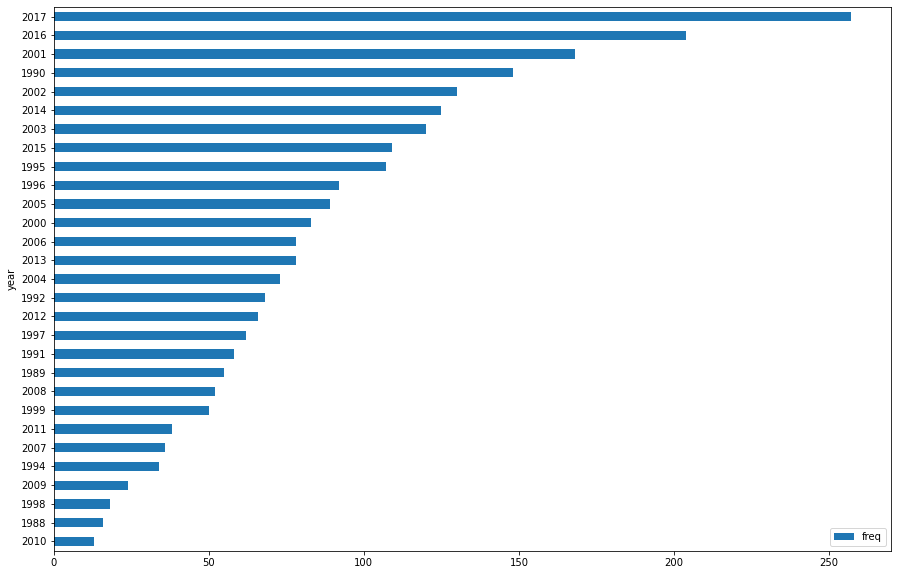

In [13]:
yfreq = yearwise.sort_values(by='freq').copy()

yfreq.plot.barh(x='year', y='freq', figsize=(15,10))

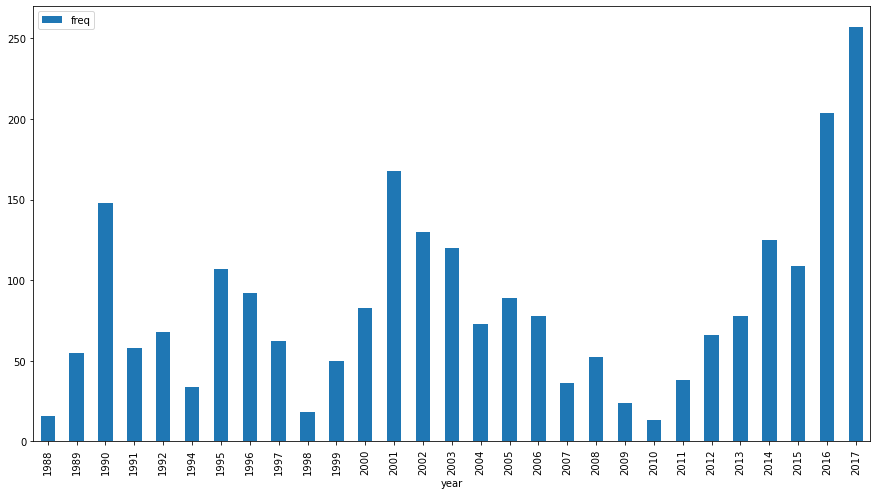

In [14]:
yfreq = yearwise.sort_values(by='year').copy()
yfreq.plot.bar(x='year', y='freq', figsize=(15,8))

In [15]:
yearwise.sort_values(by='year')

,year,freq
1,1988,16
2,1989,55
3,1990,148
4,1991,58
5,1992,68
6,1994,34
7,1995,107
8,1996,92
9,1997,62
10,1998,18


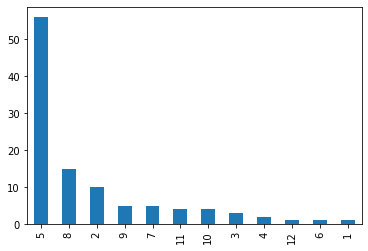

In [16]:
df1[df1.iyear==1995].imonth.value_counts().plot.bar() #plotting in which month in 1995 there were maximum number of attacks

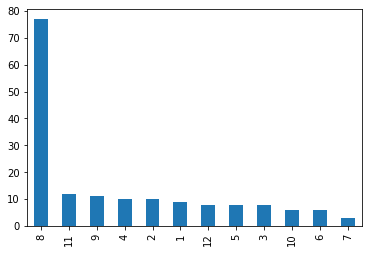

In [17]:
df1[df1.iyear==2001].imonth.value_counts().plot.bar()  #plotting in which month in 2001 there were maximum number of attacks

### Conclusion
 - From the above data it is evident that there was a surge in number of attacks in 1990, 2001 and in 2016.
 - In 1990, due to political unstability many unfortunate were recorded.
 - Then armed forces special power act was enforced in Jammu and Kashmir which lead to decrease in number of attack by 60.81%.
 - In just 3 years, attacks were reduced by 77%.
 - In 1995 there is a rise in number of attacks. But most of the attacks were executed in the month of May, its was the war between Indian forces and the 150 militiants on Charar-e-Sharief shrine.
 - Observing a bigger picture, the attacks were decreased by 88% till 1998.
 - In 2001, Kishtwar massacre and Independence day led to increase in number of attacks in the month of august.
 - From 2001 to 2010 there is massive drop in attack rate by 92.26%
 - Observing the trend pattern, there is a period of almost 10 years in which rise and decay of rate of attacks repeats.

# 3. imonth

In [18]:
# monthwise analysis
d = Counter(df1.imonth)
month = list(d.keys())
freq = list(d.values())
monthwise = pd.DataFrame({'month':month, 'freq':freq}, index=np.arange(1, len(freq)+1))
monthwise.head()

,month,freq
1,1,167
2,2,135
3,3,170
4,7,238
5,8,305


In [19]:
mfreq = monthwise.copy()
mfreq

,month,freq
1,1,167
2,2,135
3,3,170
4,7,238
5,8,305
6,9,197
7,10,202
8,11,188
9,4,230
10,5,275


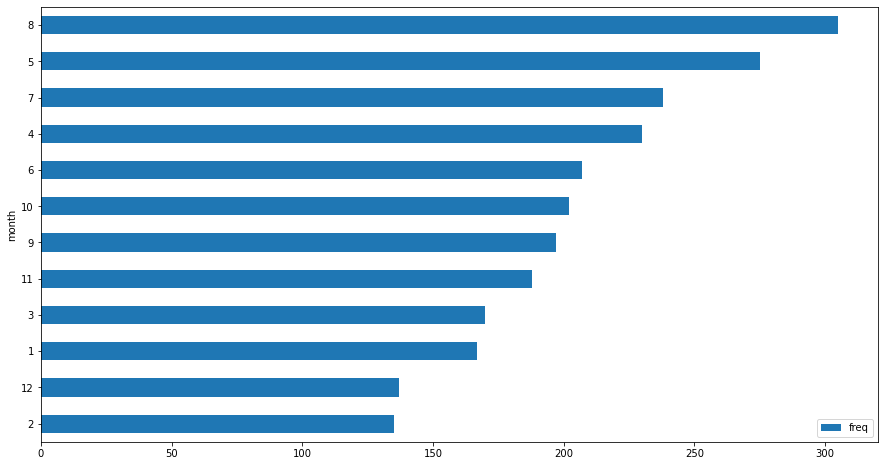

In [20]:
# month wise attack analysis from 1970 to 2017

mfreqp = monthwise.copy()
mfreqp = mfreqp.sort_values(by='freq')
mfreqp.plot.barh(x='month', y='freq', figsize=(15,8))

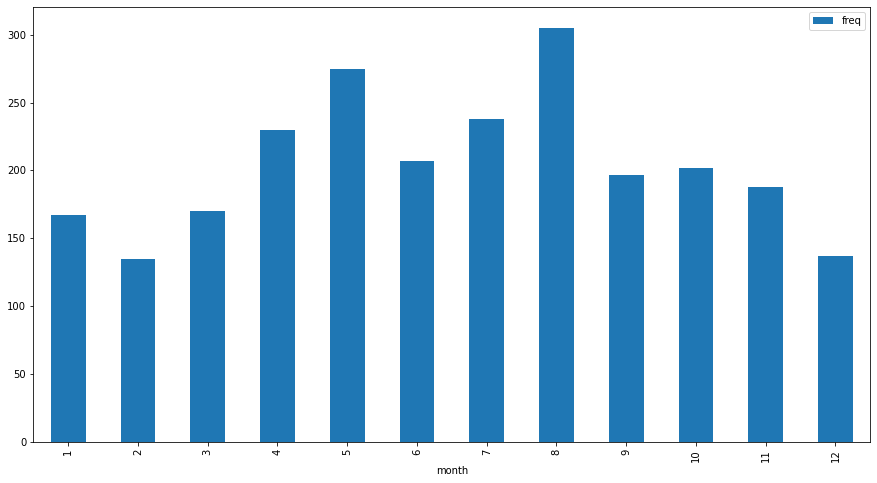

In [21]:
# month wise attack analysis from 1970 to 2017

mfreqp = monthwise.copy()
mfreqp = mfreqp.sort_values(by='month')
mfreqp.plot.bar(x='month', y='freq', figsize=(15,8))

# Observing how attack patterns were changed over time

In [22]:
yrmth = df1.eventid.astype(str).str[:6] #yearmonth to create get the frequency
d = Counter(yrmth)

eid = list(d.keys())
freq = list(d.values())

#pattern
pat = pd.DataFrame({'eid':eid, 'freq':freq}, index=np.arange(1, len(eid)+1))
pat['year'] = pat.eid.astype(str).str[:4]
pat['month'] = pat.eid.astype(str).str[4:]
pat.drop('eid', axis=1, inplace=True)
pat.head()

,freq,year,month
1,1,1988,01
2,1,1988,02
3,2,1988,03
4,3,1988,07
5,2,1988,08


In [23]:
len(df1.iyear.unique())

29

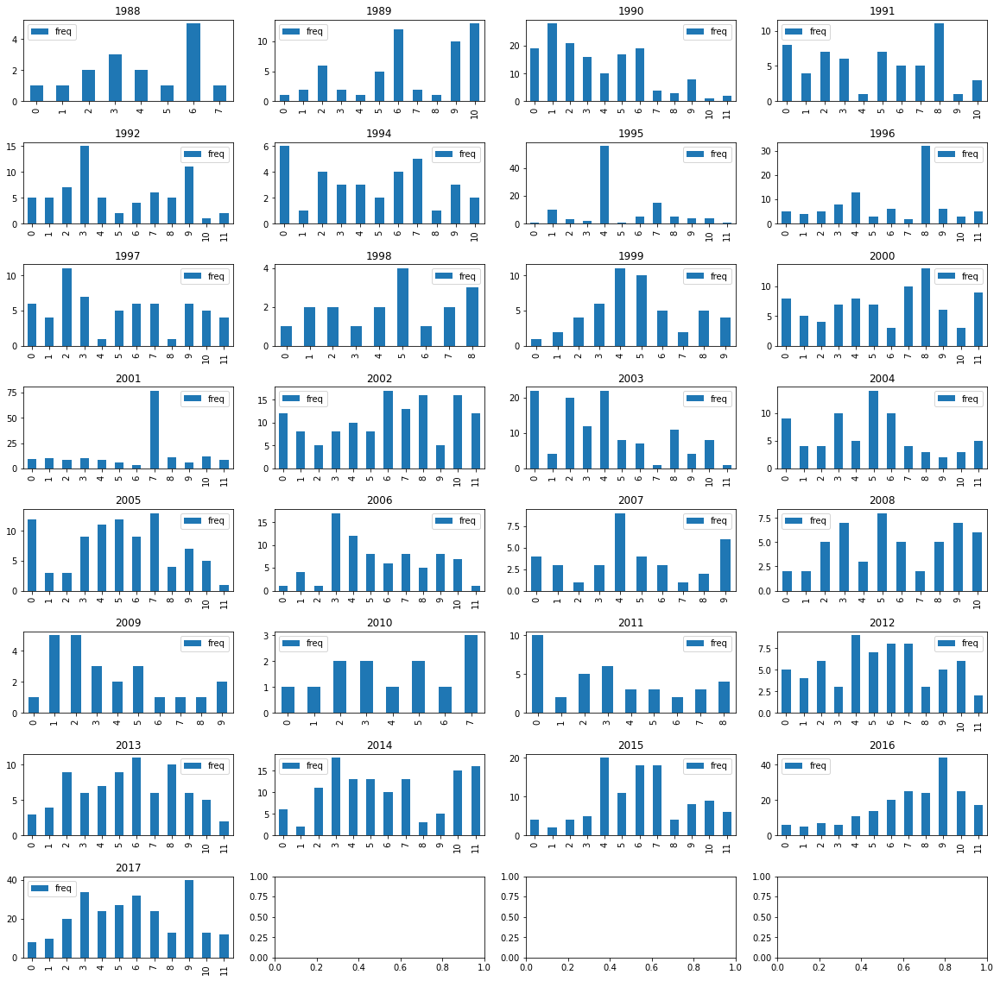

In [24]:
col = 0
row = 0
fig, ax = plt.subplots(8, 4)
plt.subplots_adjust(hspace=0.5)
for i in pat.year.unique():
    temp = pat.groupby(['year', 'month']).sum().loc[i].reset_index()
    temp.plot.bar(x='month', y='freq', ax=ax[row][col], figsize=(20, 20), title=i,use_index=False)
    if col==3:
        col=0
        row+=1
        continue
    col += 1
    
# Month 0 means exact month of that attack is unknown

In [25]:
pat.groupby(['year', 'month']).sum().loc[i].reset_index().freq.mean()

21.416666666666668

In [26]:
# finding average number of attacks per year

col = 0
row = 0
mean = []
median = []
for i in pat.year.unique():
    temp = pat.groupby(['year', 'month']).sum().loc[i].reset_index()
    mean.append(pat.groupby(['year', 'month']).sum().loc[i].reset_index().freq.mean())
    median.append(pat.groupby(['year', 'month']).sum().loc[i].reset_index().freq.median())

In [27]:
npat = yearwise.copy()
npat['mean'] = mean
npat['median'] = median
npat

,year,freq,mean,median
1,1988,16,2.000000,1.5
2,1989,55,5.000000,2.0
3,1990,148,12.333333,13.0
4,1991,58,5.272727,5.0
5,1992,68,5.666667,5.0
6,1994,34,3.090909,3.0
7,1995,107,8.916667,4.0
8,1996,92,7.666667,5.0
9,1997,62,5.166667,5.5
10,1998,18,2.000000,2.0


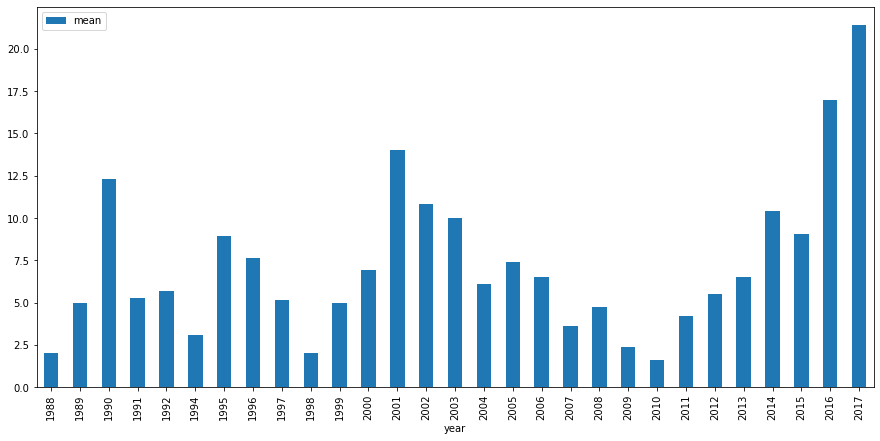

In [28]:
npat.plot.bar(x='year', y='mean', figsize=(15,7))

# Conclusion
 - Most of attacks are conducted in the month of August due to Independence Day (15 August).
 - Numbers of attacks are minimum in february.
 - Due to less number of attacks in february, it gives an edge to terrorist to implement major attacks like pulwama attack as we have less amount of data of that particular month.
 - As there is rise in technology and logistics, there is rise in number of attack per month over the year.

# 4. extended

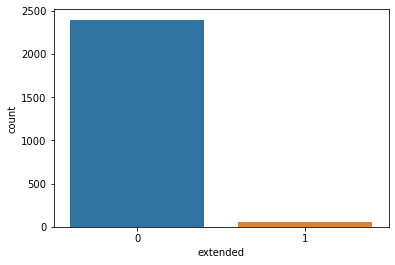

In [29]:
ext = df1.extended
sns.countplot(ext) #plotting the count of ones and zeros in the extended variable

In [30]:
ext.isna().sum()

0

In [31]:
ext.value_counts()

0    2394
1      57
Name: extended, dtype: int64

## Observation
1.	It’s a binary variable
2.	Highly unbalanced data
3.	No null values

# 5. Inclusion Criteria

## a. crit1

#### Criterion 1: POLITICAL, ECONOMIC, RELIGIOUS, OR SOCIAL GOAL (CRIT1)

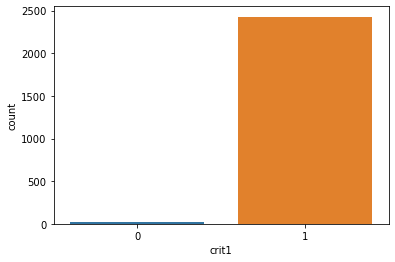

In [32]:
crit1 = df1.crit1

sns.countplot(crit1)  #plotting the count of ones and zeros in the variable

In [33]:
crit1.isna().sum() # Presence of null values?

0

In [34]:
crit1.value_counts()

1    2428
0      23
Name: crit1, dtype: int64

## b. crit2

#### Criterion 2: INTENTION TO COERCE, INTIMIDATE OR PUBLICIZE TO LARGER AUDIENCE(S) (CRIT2)

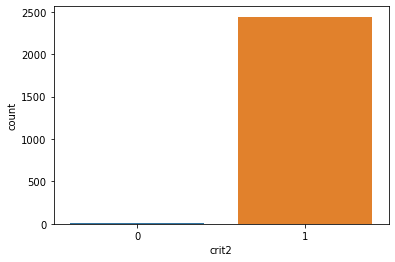

In [35]:
crit2 = df1.crit2

sns.countplot(crit2)  #plotting the count of ones and zeros in the variable

In [36]:
crit2.isna().sum()  # Presence of null values?

0

In [37]:
crit2.value_counts()

1    2442
0       9
Name: crit2, dtype: int64

## c. crit3

#### Criterion 3: OUTSIDE INTERNATIONAL HUMANITARIAN LAW (CRIT3)

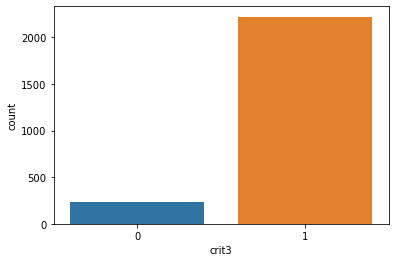

In [38]:
crit3 = df1.crit3

sns.countplot(crit3)  #plotting the count of ones and zeros in the variable

In [39]:
crit3.isna().sum()  # Presence of null values?

0

In [40]:
crit3.value_counts()

1    2220
0     231
Name: crit3, dtype: int64

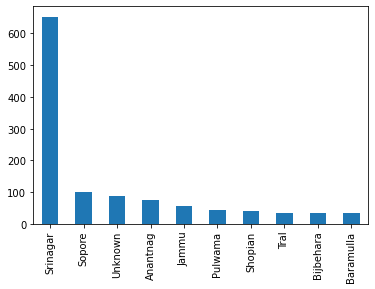

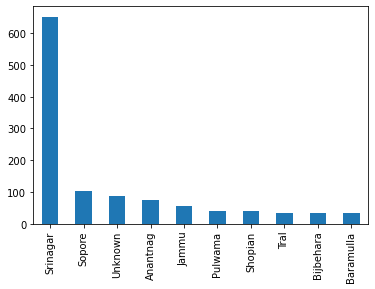

In [41]:
df1[df1.crit1==1].city.value_counts().iloc[:10].plot.bar() # Targetted city to attain political, social or economic goal
plt.show()
df1[df1.crit2==1].city.value_counts().iloc[:10].plot.bar() # Targetted city to publicize larger audience

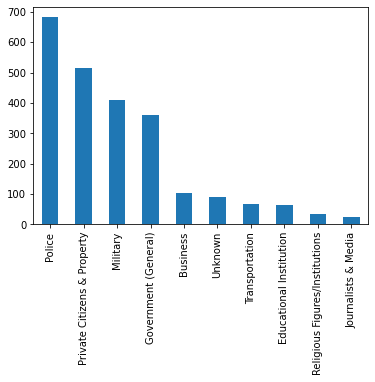

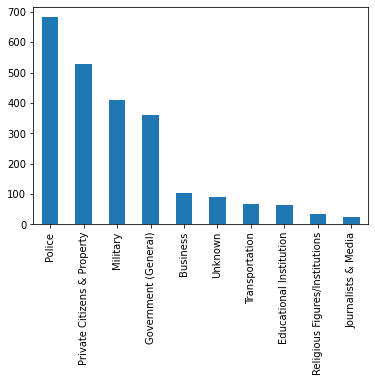

In [42]:
df1[df1.crit1==1].targtype1_txt.value_counts().iloc[:10].plot.bar() # Targetted entity to attain political, social or economic goal
plt.show()
df1[df1.crit2==1].targtype1_txt.value_counts().iloc[:10].plot.bar() # Targetted entity to publicize larger audience

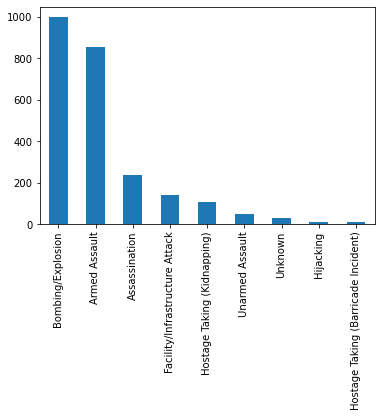

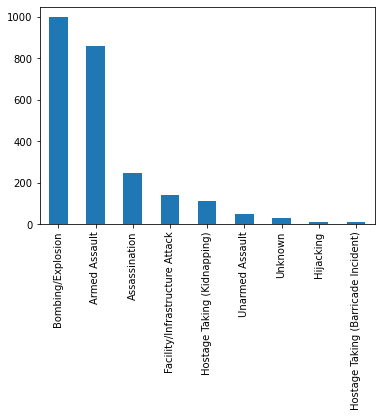

In [43]:
df1[df1.crit1==1].attacktype1_txt.value_counts().iloc[:10].plot.bar() # Attack type to attain political, social or economic goal
plt.show()
df1[df1.crit2==1].attacktype1_txt.value_counts().iloc[:10].plot.bar() # Attack type to publicize larger audience

# Overall comparision of criteria

In [44]:
crit = [crit1.value_counts()[1],crit2.value_counts()[1],crit3.value_counts()[1]]
critn = ['crit1','crit2','crit3']

In [45]:
d = {'critn':critn, 'crit':crit}
temp = pd.DataFrame(d)

,critn,crit
0,crit1,2428
1,crit2,2442
2,crit3,2220


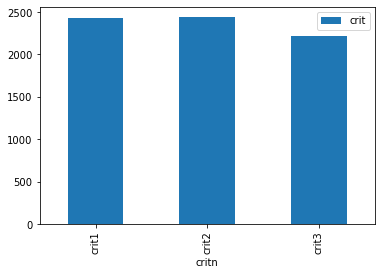

In [46]:
display(temp)
temp.plot.bar(x='critn', y='crit')

## Conclusion
 - Inclusion criteria are binary variables
 - They are highly unbalanced
 - No null value
 - Atleast two inclusion criteria will occur together
 - All the attacks are  aimed at attaining a political, economic, religious, or social goal and have an intention to coerce, intimidate, or convey some other message to a larger audience.
 - Attack are mainly executed by is bombing.
 - To attain such aim the prime target may be Srinagar and nearby areas.We need to deploy security forces in Srinagar to prevent attacks
 - Police have suffered the most number of the attacks. So we may need to upgrade their weapons and equipments to protect them from these attacks.

# 6. doubtterror

In [47]:
doubt = df1.doubtterr
doubt.value_counts() # count of unique values in the variable

 0.0    1823
 1.0     422
-9.0     206
Name: doubtterr, dtype: int64

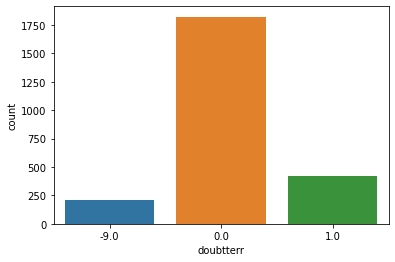

In [48]:
sns.countplot(doubt)

In [49]:
doubt.isna().sum()  # Presence of null values?

0

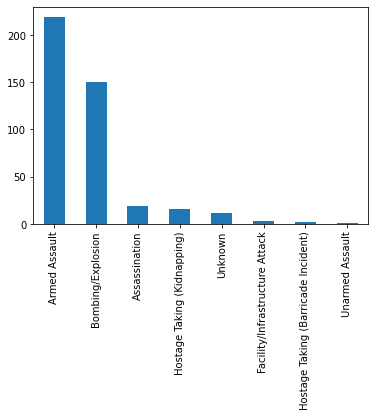

In [50]:
df1[df1.doubtterr==1].attacktype1_txt.value_counts().iloc[:10].plot.bar()

# Observation
1.	If we doubt whether the attack is real terrorism then we will raise a flag on that event.
2.	If there is a doubt we will represent it by 1 otherwise 0. A binary variable
3.	For null values it have -9
4.	For most of the attack we have classified it as terrorism. So it’s a unbalanced feature.
5. For those cases where we doubt on real terrorism, the attack type are armed assult and bombing. 
6. Most of attacks are armed assult.

# 7. alternative

In [51]:
alt = df.alternative_txt
alt.value_counts() # count of unique values in the variable

Insurgency/Guerilla Action    254
Other Crime Type               52
Lack of Intentionality         13
State Actors                   13
Intra/Inter-group Conflict      2
Name: alternative_txt, dtype: int64

In [52]:
alt.isna().sum()

1477

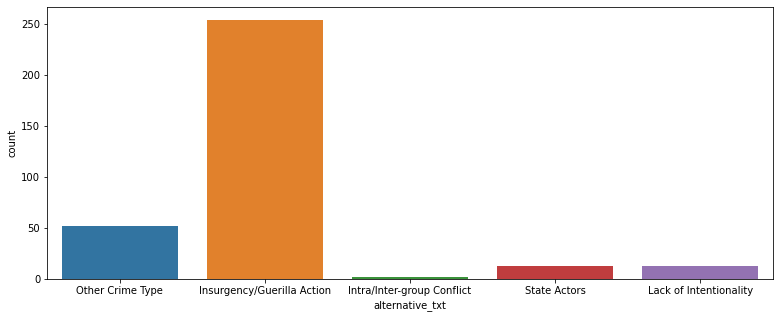

In [53]:
plt.figure(figsize=(13,5))
sns.countplot(alt)

# Observation
1.	The information about type of attack which are not considered as terrorism are consistently available after 1997
2.	It’s a nominal variable.
3.	With representation of - 

            1= Insurgency/Guerrilla Action
        
            2= Other Crime Type
            
            3= Inter/Intra-Group Conflict
                
            4= Lack of Intentionality
        
            5= State Actors



4.	It have 1477 null values
5.	Most of the attacks are Insurgency or guerrilla action.
6. This variable will have information only when doubtterr is 1

# 8. multiple

In [54]:
m = df.multiple
m.value_counts()

0    1629
1     182
Name: multiple, dtype: int64

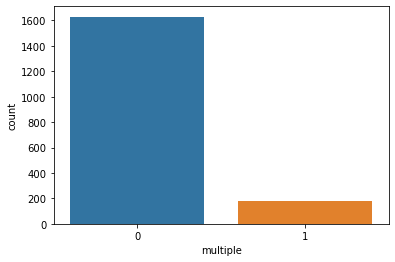

In [55]:
sns.countplot(m)

In [56]:
len(df.related.unique())

126

In [57]:
m.isna().sum()

0

# Observation
1.	Will be 1 if it is attacks are connected.
2.	It’s a binary variable
3.	No null values.
4.	This information is maintained consistently after 1997.
5.	We have very less number of connected attacks in Jammu and Kashmir.
6.	A connected attack doesn’t means that they were carried by any single organisation.
7.	The attacks were executed at various locations as a single incident but they are part of same time frame e.g.  – all attacks were executed in the night.

# 9. city

In [58]:
c = df1.city

In [59]:
c.isna().sum()

0

In [60]:
c.head()

3         Mand
4    Kherawali
5         Mand
6       Manwal
7     Srinagar
Name: city, dtype: object

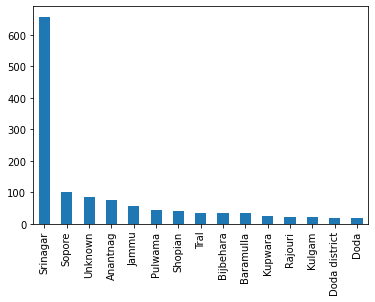

In [61]:
o = c.value_counts().head(15)
o.plot.bar(x=o.index, y=o.values)

In [62]:
(o/o.values.sum())*100 # Precentage of attacks on cities.

Srinagar         51.936759
Sopore            8.063241
Unknown           6.798419
Anantnag          6.007905
Jammu             4.426877
Pulwama           3.320158
Shopian           3.083004
Tral              2.766798
Bijbehara         2.687747
Baramulla         2.608696
Kupwara           1.897233
Rajouri           1.739130
Kulgam            1.660079
Doda district     1.501976
Doda              1.501976
Name: city, dtype: float64

# 10. Plotting coordinates

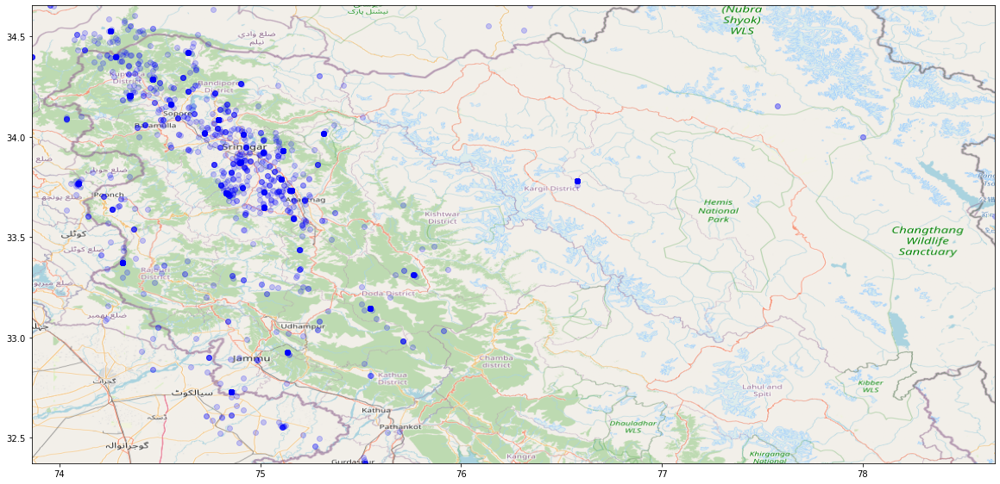

In [63]:
# PLotting all the coordinate of attack

BBox = ((df1.longitude.min(),   df1.longitude.max(),      
         df1.latitude.min(), df1.latitude.max()))

fig, ax = plt.subplots(figsize=(20,15)) 

plt.xlim(BBox[0],BBox[1])
plt.ylim(BBox[2],BBox[3])         
                 
plt.scatter(df1.longitude, df1.latitude, alpha=0.2 , c='b')
jk = plt.imread('map.png')
plt.imshow(jk, extent = BBox)

# Conclusion and Observation
 - These fields contains information about the location of city, village, or town in which the incident occurred.
 - No null values.
 - Most of attacks were executed in Srinagar.
 - Most of the cities are located near PoK and near India-Pakistan Border.
 - Terrorists enters into the state from PoK via Sopore to execute attacks in Srinagar
 - Kargil is attacked as its one of the important strategic point for India to keep control over Siachen Glacier.
 - As we go far from north west part of state(PoK) the frequency of attack goes on decreasing

# 11.attacktype1

In [64]:
a = df1.attacktype1

In [65]:
a.value_counts()

3    1000
2     861
1     246
7     139
6     110
8      48
9      29
4      10
5       8
Name: attacktype1, dtype: int64

In [66]:
a.isna().sum()

0

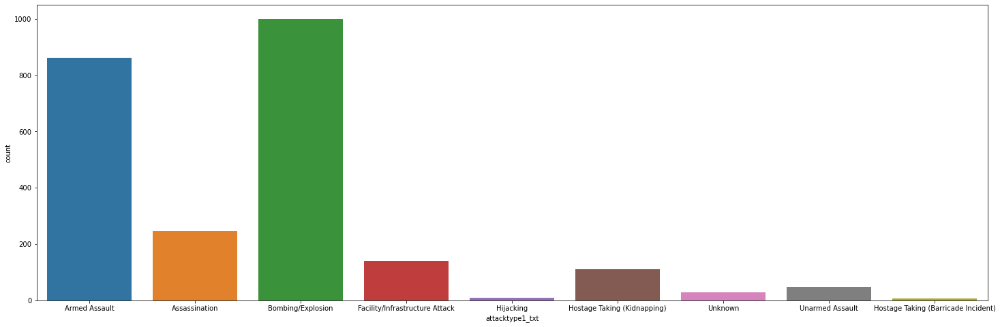

In [67]:
plt.figure(figsize=(25,8))
sns.countplot(df1.attacktype1_txt)

In [68]:
#Percentage of top 3 attack type i.e armed assault, bombing and assination comprises nearly 86% of total attack in Jammu and Kashmir
sum(df1.attacktype1_txt.value_counts()[:3])/sum(df1.attacktype1_txt.value_counts()[:]) 

0.8596491228070176

# Observation and Conclusion
1.	It’s a nominal variable
2.	No null values
3.	Nine unique values
4.	It contains the attack type information.
5.	Most of attacks were carried by bombing or explosion as they can cause much damage to the surrounding environment.
6.	Next, armed assaults are the favourite for the terrorist to target the officials and the civilians.
7.	Hostage taking (barricade incident) is the minimum. As they are mainly aimed to free any terrorist or for some ransom and these situations are rare.

# 12.sucess

In [69]:
s = df1.success

In [70]:
s.value_counts()

1    2130
0     321
Name: success, dtype: int64

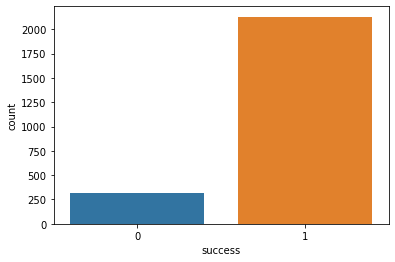

In [71]:
sns.countplot(s)# count of unique values in the variable

In [72]:
s.isna().sum()# Presence of null values?

0

## Observation
1.	It’s a binary variable.
2.	No null value.
3.	Most of the attacks are successful

# 13. suicide

In [73]:
s = df1.suicide

In [74]:
s.value_counts()# count of unique values in the variable

0    2407
1      44
Name: suicide, dtype: int64

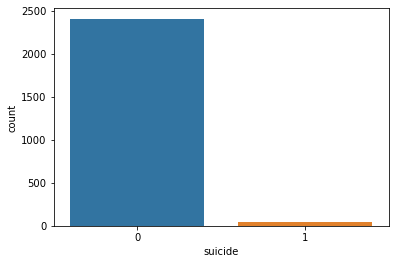

In [75]:
sns.countplot(s)

In [76]:
s.isna().sum()# Presence of null values?

0

## Observation
1.	It’s a binary variable
2.	No null value
3.	Very less number of suicide attacks.
4. If the incident was a suicide attack then coded as <code>1</code> otherwise <code>0</code>

# 14. weaptype1, weapsubtype1

In [77]:
w = df1.weaptype1 # Coded weapon variable
wt = df1.weaptype1_txt # Text of weapon variable

In [78]:
w.head()

3     5
4     5
5    13
6     5
7     6
Name: weaptype1, dtype: int64

In [79]:
w.isna().sum() # Presence of null values?

0

In [80]:
ws = df1.weapsubtype1 # coded weapon sub type
wst = df1.weapsubtype1_txt # Text of weapon sub type

In [81]:
ws.head()

3     2.0
4     2.0
5     NaN
6     2.0
7    16.0
Name: weapsubtype1, dtype: float64

In [82]:
ws.isna().sum()# Presence of null values?

114

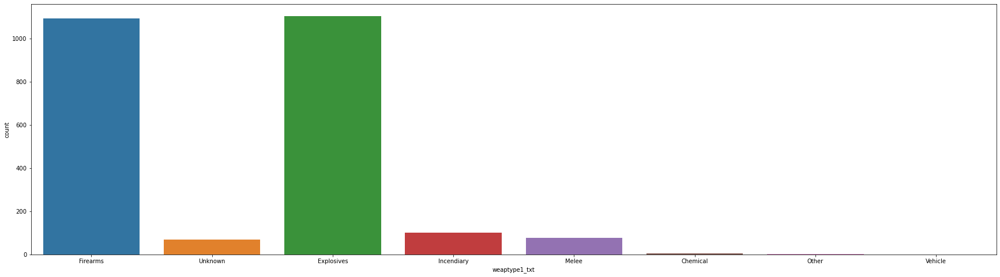

In [83]:
plt.figure(figsize=(30, 8))
sns.countplot(wt)

In [84]:
(wst.value_counts()/wst.value_counts().sum())*100  # Percentage of attack with given weapons

Unknown Gun Type                             29.396662
Grenade                                      24.176294
Automatic or Semi-Automatic Rifle            10.911425
Unknown Explosive Type                       10.783055
Handgun                                       5.905006
Landmine                                      3.722721
Projectile (rockets, mortars, RPGs, etc.)     3.209243
Other Explosive Type                          1.925546
Vehicle                                       1.711596
Blunt Object                                  1.668806
Arson/Fire                                    1.540436
Knife or Other Sharp Object                   1.412067
Molotov Cocktail/Petrol Bomb                  1.069748
Remote Trigger                                0.855798
Time Fuse                                     0.427899
Suicide (carried bodily by human being)       0.299529
Rifle/Shotgun (non-automatic)                 0.299529
Other Gun Type                                0.213950
Rope or Ot

## Observation
1.	weaptype is a nominal variable and weapsubtype is also a nominal variable.
2.	weaptype gives the broader classification of weapon used and weapsubtype gives the detailed classification of weapon used in the attack.
3.	There is no null value in weaptype
4.	There is 114 null values in weapsubtype
5.	Most of the attacks were executed with the help of firearms and explosives. It also verifies our observation of attacktype1.
6.	Rifle or some other guns with grenades are the popular weapons among terrorist.

# 15. targtype1

In [85]:
t = df1.targtype1

In [86]:
t.head()

3     3
4    14
5    14
6    14
7    14
Name: targtype1, dtype: int64

In [87]:
t.isna().sum()  # Presence of null values?

0

In [88]:
ts = df1.targtype1_txt

In [89]:
ts.head()

3                         Police
4    Private Citizens & Property
5    Private Citizens & Property
6    Private Citizens & Property
7    Private Citizens & Property
Name: targtype1_txt, dtype: object

In [90]:
len(ts.unique())

19

In [91]:
ts.value_counts() # count of unique values in the variable

Police                            682
Private Citizens & Property       532
Military                          410
Government (General)              363
Business                          104
Unknown                            91
Transportation                     67
Educational Institution            63
Religious Figures/Institutions     35
Journalists & Media                25
Tourists                           19
Terrorists/Non-State Militia       18
Telecommunication                  16
Violent Political Party            13
Utilities                           8
Airports & Aircraft                 2
NGO                                 1
Food or Water Supply                1
Government (Diplomatic)             1
Name: targtype1_txt, dtype: int64

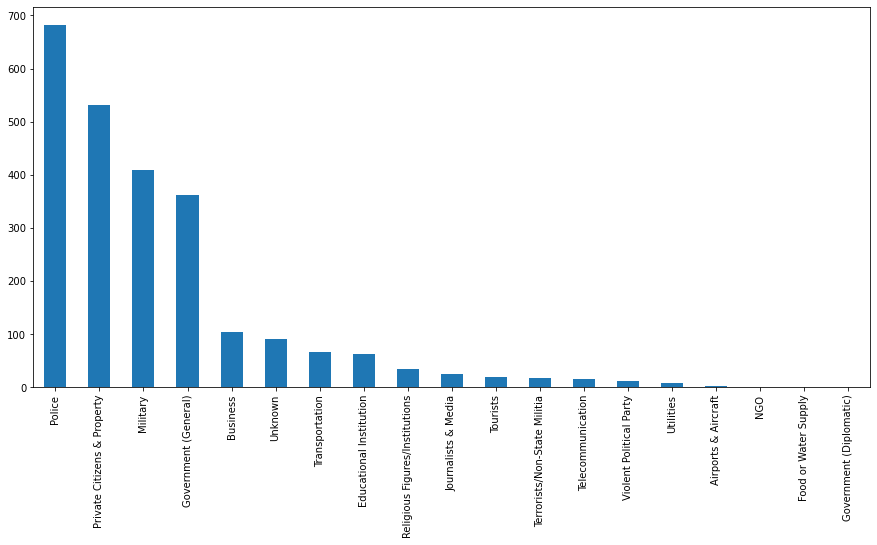

In [92]:
plt.figure(figsize=(15, 7))
ts.value_counts().plot.bar(x=ts.index, y=ts.values)

In [93]:
ts.value_counts().apply(lambda x:(x/ts.value_counts().sum())*100) # Percentage of attack on particular target

Police                            27.825377
Private Citizens & Property       21.705426
Military                          16.727866
Government (General)              14.810282
Business                           4.243166
Unknown                            3.712770
Transportation                     2.733578
Educational Institution            2.570379
Religious Figures/Institutions     1.427989
Journalists & Media                1.019992
Tourists                           0.775194
Terrorists/Non-State Militia       0.734394
Telecommunication                  0.652795
Violent Political Party            0.530396
Utilities                          0.326397
Airports & Aircraft                0.081599
NGO                                0.040800
Food or Water Supply               0.040800
Government (Diplomatic)            0.040800
Name: targtype1_txt, dtype: float64

## Observation
1.	It’s a nominal variable
2.	No null value
3.	It gives the information about the target.
4.	It has 19 unique values.
5.	Police, private citizen and property are attacked most which constitute of nearly fifty per cent of total attacks.
6.	NGOs, Diplomatic bodies, Food and water supplies are not one of the favourite targets because if they target those points then terrorists also have to suffer. But they were also attacked. 
7.	Only one attack are registered the above targets(mentioned in 6).

# 16. targsubtype1

In [94]:
ts = df1.targsubtype1

In [95]:
ts.isna().sum()

136

In [96]:
ts.head()

3    25.0
4    78.0
5    72.0
6    67.0
7    82.0
Name: targsubtype1, dtype: float64

In [97]:
tst = df1.targsubtype1_txt

In [98]:
tst.isna().sum()

136

In [99]:
tst.value_counts()[:15]

Police Security Forces/Officers                            348
Politician or Political Party Movement/Meeting/Rally       184
Police Building (headquarters, station, school)            173
Military Unit/Patrol/Convoy                                155
Police Patrol (including vehicles and convoys)             149
Unnamed Civilian/Unspecified                               112
Government Personnel (excluding police, military)          101
Military Personnel (soldiers, troops, officers, forces)     96
Named Civilian                                              82
Military Barracks/Base/Headquarters/Checkpost               77
Political Party Member/Rally                                77
Religion Identified                                         49
Laborer (General)/Occupation Identified                     47
School/University/Educational Building                      45
Government Building/Facility/Office                         41
Name: targsubtype1_txt, dtype: int64

In [100]:
len(tst.unique())

82

In [101]:
tst.value_counts().apply(lambda x:(x/tst.value_counts().sum())*100)[:15] # Percentage of attack on particular target (top 15)

Police Security Forces/Officers                            15.032397
Politician or Political Party Movement/Meeting/Rally        7.948164
Police Building (headquarters, station, school)             7.473002
Military Unit/Patrol/Convoy                                 6.695464
Police Patrol (including vehicles and convoys)              6.436285
Unnamed Civilian/Unspecified                                4.838013
Government Personnel (excluding police, military)           4.362851
Military Personnel (soldiers, troops, officers, forces)     4.146868
Named Civilian                                              3.542117
Military Barracks/Base/Headquarters/Checkpost               3.326134
Political Party Member/Rally                                3.326134
Religion Identified                                         2.116631
Laborer (General)/Occupation Identified                     2.030238
School/University/Educational Building                      1.943844
Government Building/Facility/Offic

## Observation
1.	It’s a nominal variable.
2.	It has 136 null values.
3.	It gives the specific target type like which business or government body was attacked.
4.	We have 82 different sub target types.
5.	Police security forces or officers are one of the favourite targets for terrorists.
6.	Political parties, police and military are attacked most. Even they constitute of nearly 50% of total attack.

# 17. gname

In [102]:
g = df1.gname # gname is group name

In [103]:
g.head()

3            Unknown
4    Sikh Extremists
5            Unknown
6            Unknown
7    Sikh Extremists
Name: gname, dtype: object

In [104]:
len(g.unique()) #total uniue values in this variable

65

In [105]:
(g.value_counts()[:15]/g.value_counts().sum())*100  # Percentage of attack by particular group

Unknown                               59.934721
Hizbul Mujahideen (HM)                 7.874337
Lashkar-e-Taiba (LeT)                  6.731946
Muslim Separatists                     4.610363
Kashmiri extremists                    2.978376
Muslim Militants                       2.855977
Separatists                            2.080783
Jammu and Kashmir Liberation Front     2.039984
Jaish-e-Mohammad (JeM)                 1.264790
Muslim extremists                      1.101591
Militants                              0.938392
Sikh Extremists                        0.775194
Al-Mansoorian                          0.652795
Lashkar-e-Islam (India)                0.530396
Tehrik al-Mojahedin                    0.530396
Name: gname, dtype: float64

## Observation
1.	It’s a categorical string type variable. Data have no order in it.
2.	We have 1469 null values coded with Unknown which is almost 60% of data.
3.	Most of attacks were executed by <code>Hizbul Mujahideen (8%)</code>, <code>Lashkar-e-taiba (7%)</code> and other <code>separatist</code>.

# 18. nperps

In [106]:
p = df1.nperps

In [107]:
p.head()

3   NaN
4   NaN
5   NaN
6   NaN
7   NaN
Name: nperps, dtype: float64

In [108]:
p.isna().sum() # Presence of null values?

1296

## Observation
1.	It’s a ratio variable.
2.	It has 1296 null values
3.	This variable gives info about number of perpetrator

# 19. nperpcap

In [109]:
c = df.nperpcap

In [110]:
c.head()

0    0.0
1    NaN
2    NaN
3    NaN
4    NaN
Name: nperpcap, dtype: float64

In [111]:
c.isna().sum()

143

## Observation

1.	It’s a ratio variable
2.	It has information about the number of captured perpetrator.
3.	It has 143 null values.
4.	Its recorded consistently after 1997 


# 20. claimed

In [112]:
cl = df.claimed

In [113]:
cl.isna().sum()

0

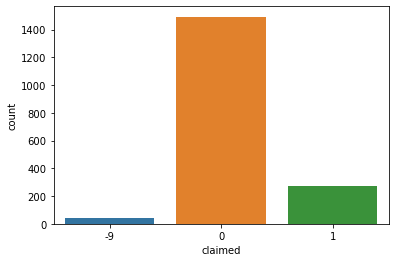

In [114]:
sns.countplot(cl)

## Observation
1.	It’s a binary variable.
2.	It has no null value.
3.	Unknown values are encoded by -9.
4.	This field is used to indicate whether a group or person(s) claimed responsibility for the attack or not.
5.	Most of the cases are unclaimed and thats why we have many `Unknowns` in variable <code>gname</code>.
6.	This information is consistently available after 1997


# 21. motive

In [115]:
m = df.motive

In [116]:
m.head()

0    Unknown
1    Unknown
2    Unknown
3    Unknown
4    Unknown
Name: motive, dtype: object

In [117]:
m.isna().sum() # Presence of null values?

701

In [118]:
# Removing stopwords from the text
motive = []
for i in m.values:
    if i not in [np.nan, 'Unknown', *list(STOPWORDS), 'The']:
        motive.append(i.lower())    

In [119]:
# Removing unwanted phrases and texts from the motive
allmotive = ' '.join(motive)
remove = [
    'carried', 'noted', 'The specific motive for the attack is unknown','however', 'specific motive is unknown',
    'specific motive for the attack is unknown','specific motive was unknown', 'attack','claimed responsibility','stated',
    'source','suspected', 'part', 'occurred', 'incident', 'hizbul', 'mujahideen', 'kashmir', 'hm', 'although', 'note', 'jammu', 
    'group','used', 'excessive', 'region', 'believed', 'militant', 'area', 'people','unknown', 'indian', 'member', 'called', 
    'held','lashkar', 'taiba', 'two', 'authorities', 'military', 'let', 'force', 'police', 'army', 'may', 'security', 'assailants',
    'december', 'separatist', 'november', 'recently', 'april', 'killed', 'victim', 'targeted', 'operation', 'demanded', 'state', 
    'india', 'larger', 'officer', 'leave', 'killed', 'killing', 'trend', 'believe', 'tauseef sheikh'
]

for r in remove:
    allmotive = allmotive.replace(r, '')

# Creating word cloud
wc = WordCloud(width = 600, height = 600, 
                background_color ='white', 
                stopwords = set(STOPWORDS), 
                min_font_size = 10).generate(allmotive) 

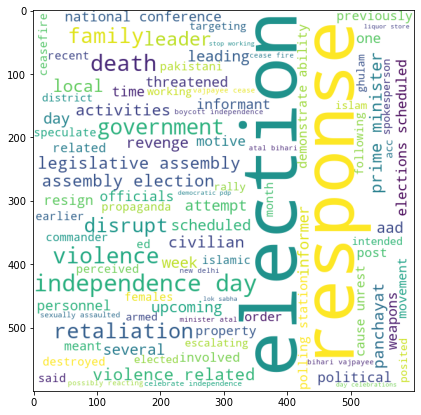

In [120]:
plt.figure(figsize=(15,7))
plt.imshow(wc)

## Observation
1.	This information is consistently available after 1997
2.	It has 701 null values.
3.	This variable gives info about any specific motive of attack.
4.	Attacks were motivated by elections or operation of security forces against hizbul muzahiddin member.
5.	Attacks were motivated as a response to security forces operations.
6.	The violence is not only affecting the militants or the security forces but also their families. So to take revenge attacks are executed.
7. Militants targets informers of security forces.
8. Militants also attack on some important days like independence day to disturb the status quo.
9. They also threaten security forces officers to resign their job.

# 22. nkill

In [121]:
k = df1.nkill

In [122]:
k.head()

3    2.0
4    4.0
5    3.0
6    4.0
7    0.0
Name: nkill, dtype: float64

In [123]:
k.isna().sum() # Presence of null values?

27

In [124]:
k.max() # Recorded maximum kills

35.0

In [125]:
k.min()  # Recorded minimum kills

0.0

## Observation
1.	It’s a ratio variable.
2.	It has 27 null values.
3.	Maximum number of causalities is 35


# 23. nkillter

In [126]:
kt = df1.nkillter

In [127]:
kt.head()

3    NaN
4    NaN
5    NaN
6    NaN
7    0.0
Name: nkillter, dtype: float64

In [128]:
kt.isna().sum() # Presence of null values?

657

In [129]:
kt.max() # Recorded maximum kills

15.0

In [130]:
kt.min() # Recorded minimum kills

0.0

## Observation
1.	It’s a ratio variable
2.	It has 657 null values
3.	Maximum number of terrorist killed are 15


# 24. nwound

In [131]:
w = df1.nwound

In [132]:
w.head()

3    0.0
4    5.0
5    0.0
6    0.0
7    0.0
Name: nwound, dtype: float64

In [133]:
w.isna().sum() # Presence of null values?

84

In [134]:
w.max(), w.min() # Recorded maximum and minimum wounded

(100.0, 0.0)

## Observation
1.	It’s a ratio variable
2.	It has 84 null values
3.	At max 100 people were wounded in attack.


# 25. nwoundte

In [135]:
wt = df1.nwoundte

In [136]:
wt.head()

3    NaN
4    NaN
5    NaN
6    NaN
7    0.0
Name: nwoundte, dtype: float64

In [137]:
wt.isna().sum()

705

In [138]:
wt.max()

5.0

In [139]:
wt.min()

0.0

## Observation
1.	It’s a ratio variable
2.	It has 705 null values
3.	Maximum number terrorist injured is 5


# 26. property

In [140]:
p = df1.property

In [141]:
p.unique() # all unique values in this variable

array([ 1,  0, -9], dtype=int64)

In [142]:
p.head()

3    1
4    1
5    0
6    0
7    1
Name: property, dtype: int64

In [143]:
p.isna().sum()

0

## Observation
1.	It’s a binary variable
2.	It tells if property was damaged in the incident
3.	It has no null values


# 27. ishostkid

In [144]:
h = df1.ishostkid

In [145]:
h.head()

3    0.0
4    0.0
5    0.0
6    0.0
7    0.0
Name: ishostkid, dtype: float64

In [146]:
h.isna().sum()

0

## Observation
1.	It’s a binary variable.
2.	It has no null value
3.	It tells if hostage taking were the part of incident or not.


# 28. hostkidoutcome

In [147]:
r = df1.hostkidoutcome

In [148]:
r.unique() # all unique values in this variable

array([nan,  2.,  4.,  7.,  3.,  5.,  6.])

In [149]:
r.isna().sum()

2333

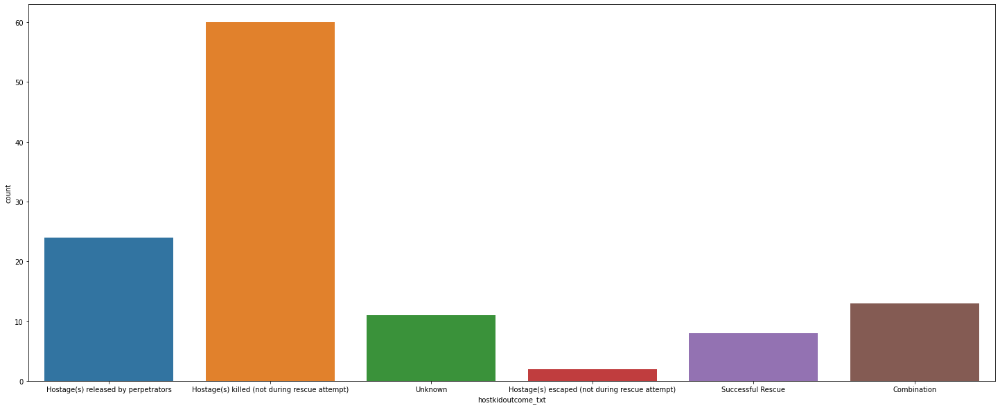

In [150]:
plt.figure(figsize=(25,10))
sns.countplot(df1.hostkidoutcome_txt)

## Observation

 - Its a nominal variable
 - It have 6 unique values 
 - It has 2333 nulll values.
 - This variable gives the information about the fate of hostage.
 - In most of the cases hostage were killed by the perpetrator.


<br>

# <center><u><a id='multi'> Multivariate Analysis<a></u>

# Analysis of attack pattern over the year

In [151]:
def loc(temp, c, legend, ax):
    BBox = ((df1.longitude.min(),   df1.longitude.max(),      
             df1.latitude.min(), df1.latitude.max()))

    ax.set_xlim(BBox[0],BBox[1])
    ax.set_ylim(BBox[2],BBox[3])         

    ax.scatter(temp.longitude, temp.latitude, alpha=0.2 , c=c)
    jk = plt.imread('map.png')
    ax.legend([legend], prop={'size':14})
    ax.imshow(jk, extent = BBox)

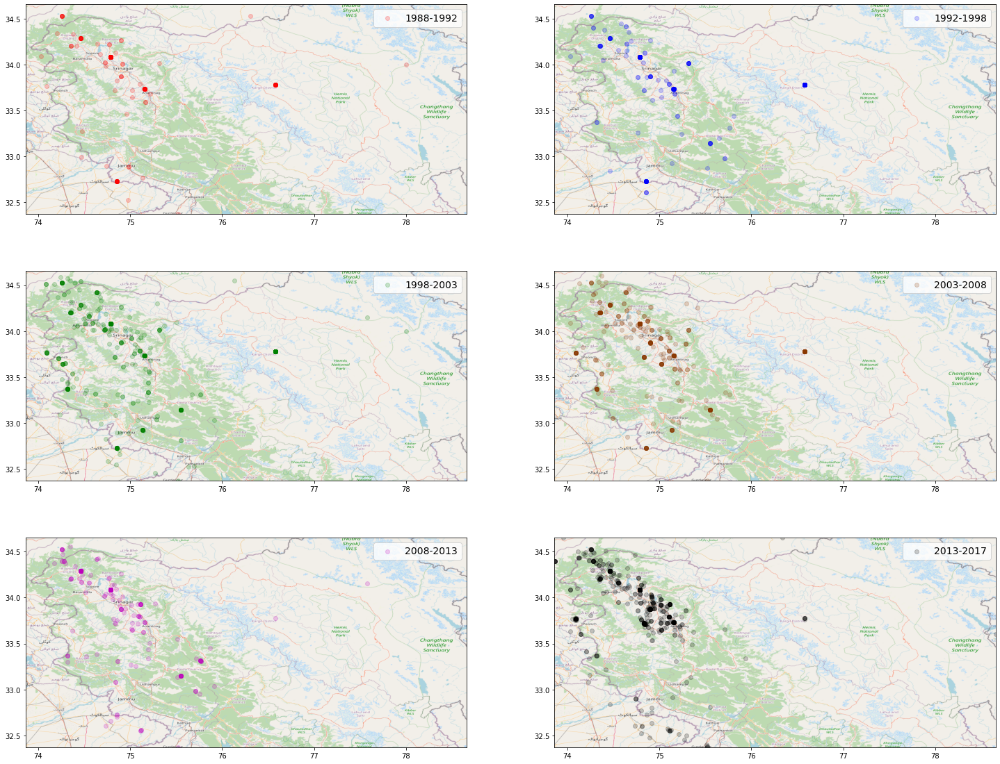

In [152]:
# Plotting attack pattern over the year
end = 4
start = 0
color = ['r', 'b', 'g', '#8a3801', 'm', 'k']

fig, ax = plt.subplots(3, 2, figsize=(25,20)) 
row = 0
col = 0
for _ in range(6):
    try:
        syear = df1.iyear.unique()[start]
        eyear = df1.iyear.unique()[end]
        temp = df1[(df1.iyear>=syear) & (df1.iyear<eyear)]
    except:
        syear = df1.iyear.unique()[start]
        eyear = df1.iyear.unique()[end-1]        
        temp = df1[(df1.iyear>=syear) & (df1.iyear<eyear)]
    start = end
    end+=5
    loc(temp, color[_], f'{syear}-{eyear}', ax[row][col])
    if col:
        row += 1
        col = 0
        continue
    col+=1
    

## Observation
 - Over the years, terrorists have expanded the target location and the frequency of attack.
 - From the beginning Kargil is one of favourite target for militants.
 - Mainly the attacks are executed in Srinagar.
 - At the beginning the attacks were concentrated near Sopore.
 - The above mentioned point is also true as the base of militants are in PoK and they expanded their target location over the year.

# Analysis of attack pattern over the month

In [153]:
def loc(temp, c, legend, ax):
    BBox = ((df1.longitude.min(),   df1.longitude.max(),      
             df1.latitude.min(), df1.latitude.max()))

    ax.set_xlim(BBox[0],BBox[1])
    ax.set_ylim(BBox[2],BBox[3])         

    ax.scatter(temp.longitude, temp.latitude, alpha=0.3 , c=c)
    jk = plt.imread('map.png')
    ax.legend([legend])
    ax.imshow(jk, extent = BBox)

In [154]:
month = {
    1:'January',
    2:'February',
    3:'March',
    4:'April',
    5:'May',
    6:'June',
    7:'July',
    8:'August',
    9:'September',
    10:'Octoboer',
    11:'November',
    12:'December'
}

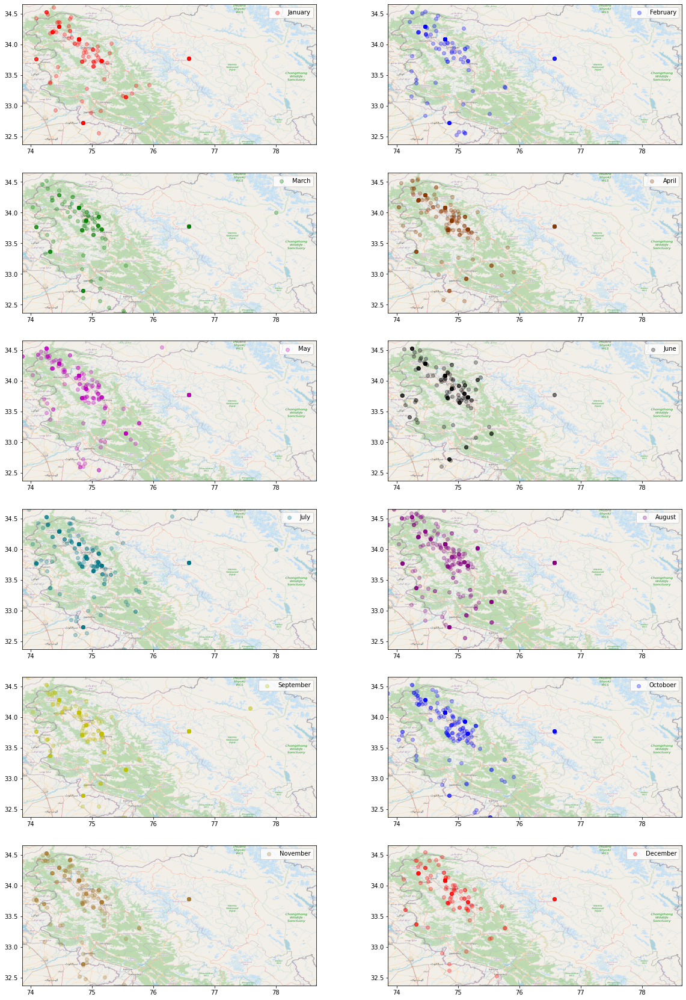

In [155]:
# Plotting attack pattern over the month

color = ['r', 'b', 'g', '#8a3801', 'm', 'k', '#017585', '#850181', 'y', 'b', '#a87d32', 'r']
fig, ax = plt.subplots(nrows=6, ncols=2, figsize=(20,30)) 
row = 0
col = 0
for m in range(12):
    temp = df1[(df1.imonth==m+1)]
    end+=5
    loc(temp, color[m], f'{month[m+1]}', ax[row][col])
    if col:
        row += 1
        col = 0
        continue
    col+=1
    

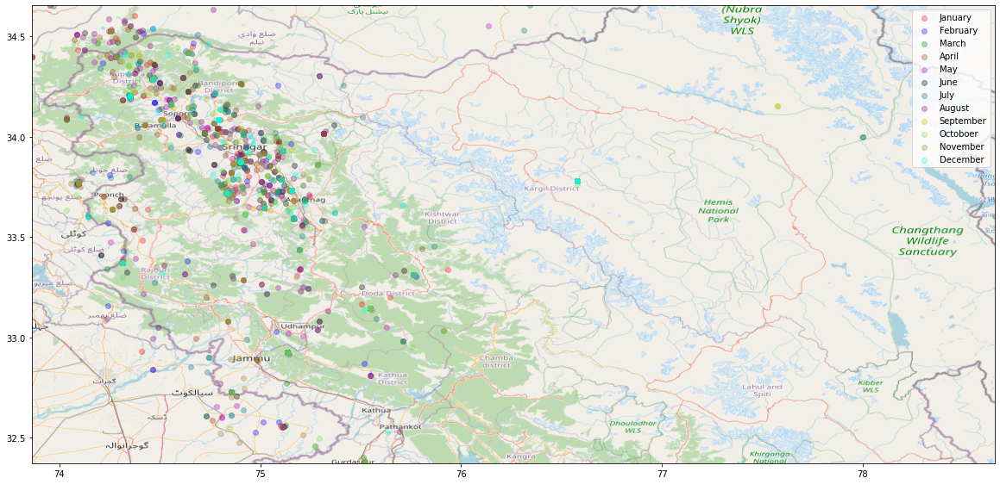

In [156]:
color = ['r', 'b', 'g', '#8a3801', 'm', 'k', '#017585', '#850181', 'y', '#72e04a', '#a87d32', '#00ffe5']
BBox = ((df1.longitude.min(),   df1.longitude.max(),      
         df1.latitude.min(), df1.latitude.max()))
     
jk = plt.imread('map.png')

fig, ax = plt.subplots(figsize=(20,30)) 

for m in range(12):
    temp = df1[(df1.imonth==m+1)]
    plt.scatter(temp.longitude, temp.latitude, alpha=0.3 , c=color[m])
    plt.legend([mnth for mnth in month.values()])
    plt.imshow(jk, extent = BBox)

# Reason and region of attack

In [157]:
# Plotting inclusion criteria and region of attacks

def loc(temp, c, title, ax):
    BBox = ((df1.longitude.min(),   df1.longitude.max(),      
             df1.latitude.min(), df1.latitude.max()))

    ax.set_xlim(BBox[0],BBox[1])
    ax.set_ylim(BBox[2],BBox[3])         

    ax.scatter(temp.longitude, temp.latitude, alpha=0.3 , c=c)
    jk = plt.imread('map.png')
    ax.titlesize='large'
    ax.set_title(title, fontdict={'fontsize': 18})
    ax.imshow(jk, extent = BBox)

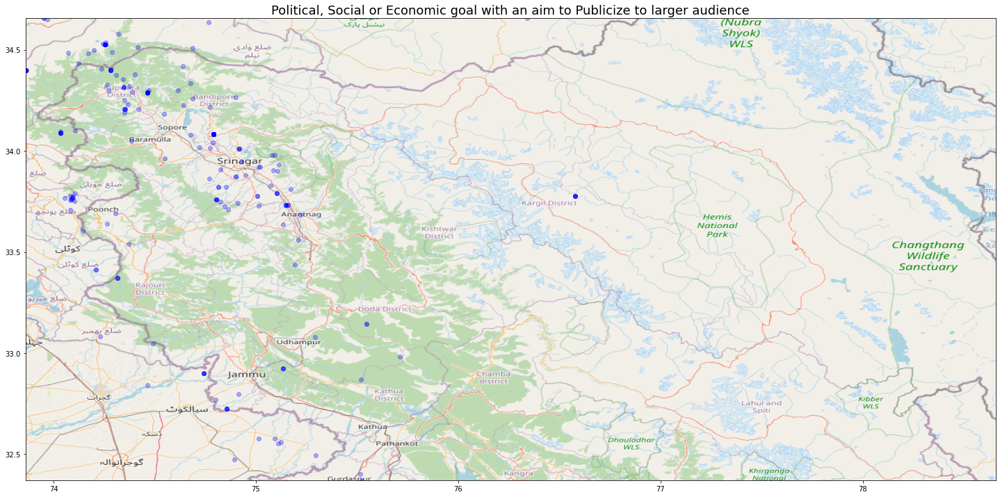

In [158]:
# crit1, crit2
fig, ax = plt.subplots(figsize=(25,20)) 
loc(df1[(df1.crit1==1) & (df1.crit2==1) & (df1.crit3==0)], 'b', 'Political, Social or Economic goal with an aim to Publicize to larger audience', ax)

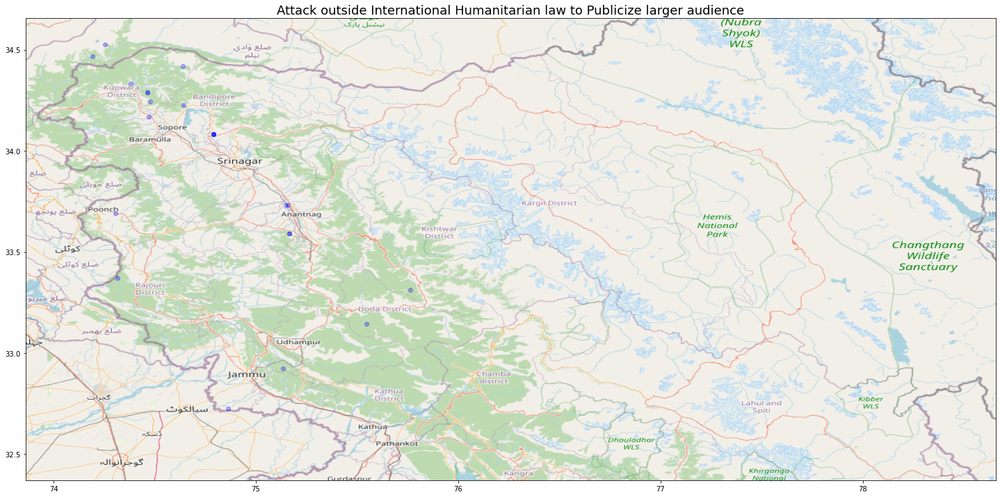

In [159]:
# crit2, crit3
fig, ax = plt.subplots(figsize=(25,20)) 
loc(df1[(df1.crit1==0) & (df1.crit2==1) & (df1.crit3==1)], 'b', 'Attack outside International Humanitarian law to Publicize larger audience', ax)

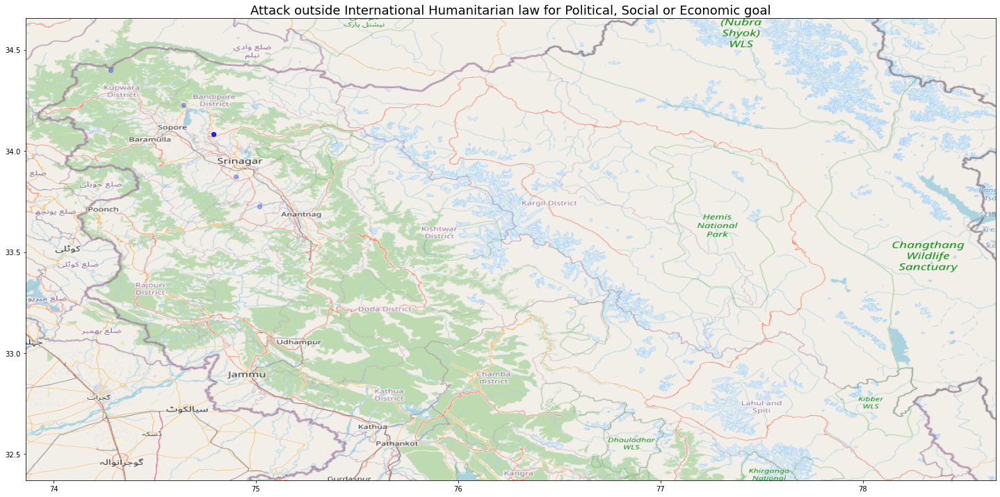

In [160]:
# crit1, crit3
fig, ax = plt.subplots(figsize=(25,20)) 
loc(df1[(df1.crit1==1) & (df1.crit2==0) & (df1.crit3==1)], 'b', 'Attack outside International Humanitarian law for Political, Social or Economic goal', ax)

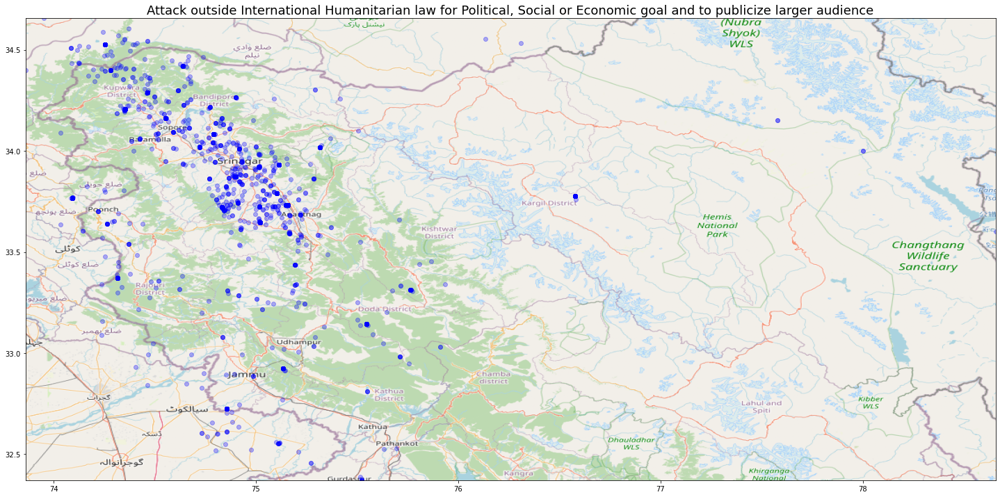

In [161]:
# crit1, crit2, crit3
fig, ax = plt.subplots(figsize=(25,20)) 
loc(df1[(df1.crit1==1) & (df1.crit2==1) & (df1.crit3==1)], 'b', 'Attack outside International Humanitarian law for Political, Social or Economic goal and to publicize larger audience', ax)

## Conclusion

 - When terrorists are aimed to attain a political, economic, religious, or social goal and have an intention to coerce, intimidate, or convey some other message to a larger audience then only they attack on Kargil.
 - To attain the above case they will target Kupwara district or Srinagar.
 - Attacks are also spread across India Pakistan Border like, Poonch, Jammu and pathankot
 - Mainly all the attacks are executed in the north western part of Kashmir
 - Attack outside International Humanitarian law in order to Publicize larger audience is very less. But to attain such aim terrorists will target mainly Sopore and Kupwara District.


## Analysing those incidents which are in doubt to be called as terrorism

In [162]:
def loc(temp, c, title, ax):
    BBox = ((df1.longitude.min(),   df1.longitude.max(),      
             df1.latitude.min(), df1.latitude.max()))

    ax.set_xlim(BBox[0],BBox[1])
    ax.set_ylim(BBox[2],BBox[3])         

    ax.scatter(temp.longitude, temp.latitude, alpha=0.3 , c=c)
    jk = plt.imread('map.png')
    ax.titlesize='large'
    ax.set_title(title, fontdict={'fontsize': 18})
    ax.imshow(jk, extent = BBox)

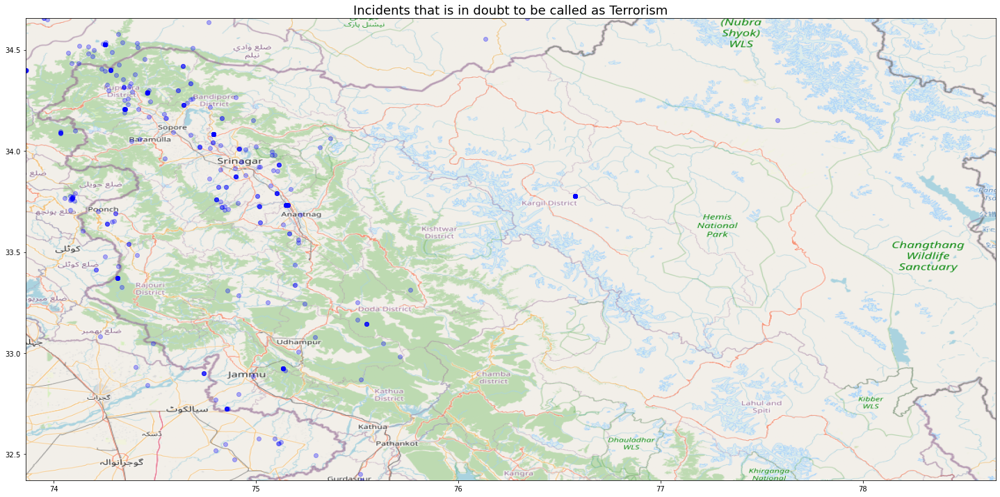

In [163]:
fig, ax = plt.subplots(figsize=(25,20)) 
loc(df1[(df1.doubtterr==1)], 'b', 'Incidents that is in doubt to be called as Terrorism', ax)

In [164]:
np.delete(df1.alternative_txt.unique(), 0)

array(['Insurgency/Guerilla Action', 'Intra/Inter-group Conflict',
       'Other Crime Type', 'State Actors', 'Lack of Intentionality'],
      dtype=object)

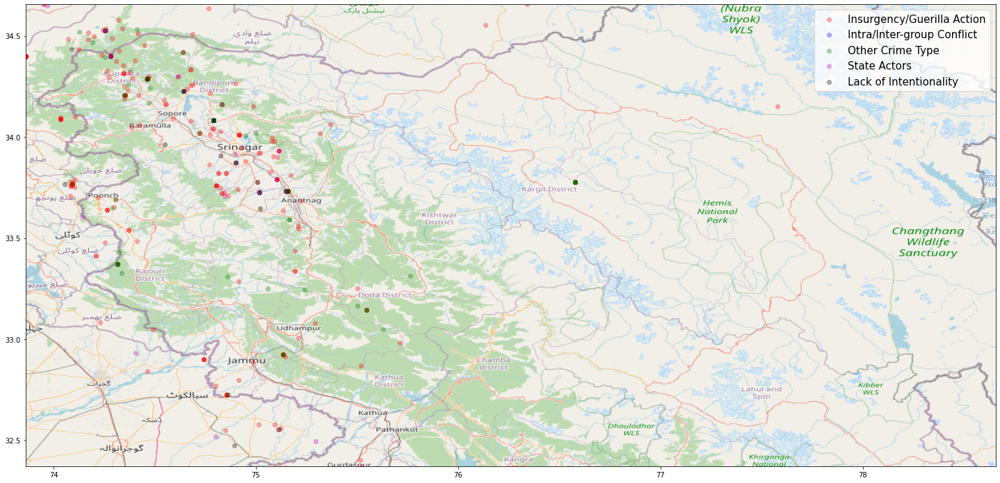

In [165]:
fig, ax = plt.subplots(figsize=(25,20))
color = ['r', 'b', 'g', 'm', 'k']
c = 0
BBox = ((df1.longitude.min(),   df1.longitude.max(),      
         df1.latitude.min(), df1.latitude.max()))
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
jk = plt.imread('map.png')
for i in np.delete(df1.alternative_txt.unique(), 0):
    temp = df1[(df1.doubtterr==1) & (df1.alternative_txt==i)]
    ax.scatter(temp.longitude, temp.latitude, alpha=0.3 , c=color[c])
    ax.legend([leg for leg in np.delete(df1.alternative_txt.unique(), 0)], prop={'size': 15})
    ax.imshow(jk, extent = BBox)
    c+=1

## Conclusion

 - As we have observed previously, such kind of attacks are either insurgency or guerilla action.
 - These attacks are mainly targetted in Srinagar and Sopore.
 - Attacks with lack of intensionality are targetted in Doda District or in Rajouri District.

# Analysis of weapon and location

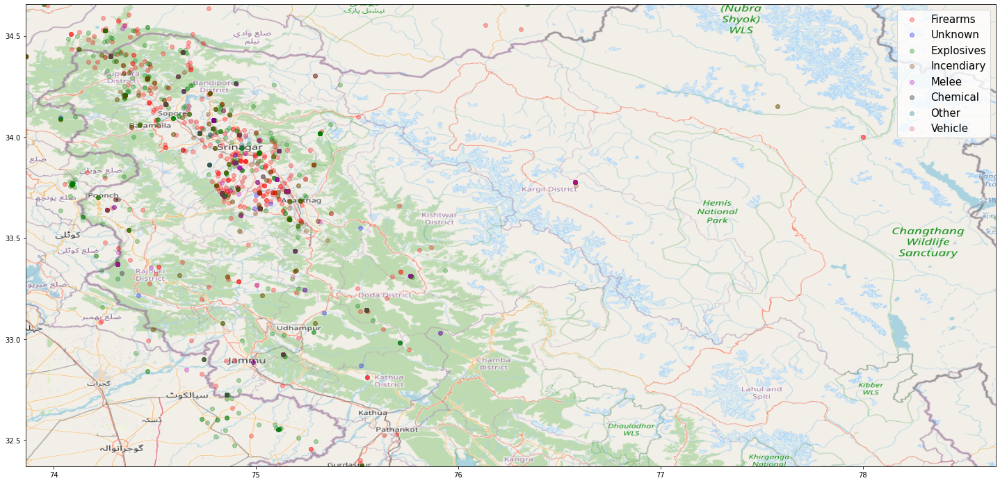

In [166]:
# Plotting the weapon used and location of attack

fig, ax = plt.subplots(figsize=(25,20))
color = ['r', 'b', 'g', '#8a3801', 'm', 'k', '#017585', '#e75480',]
c = 0
BBox = ((df1.longitude.min(),   df1.longitude.max(),      
         df1.latitude.min(), df1.latitude.max()))
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
jk = plt.imread('map.png')
for i in df1.weaptype1_txt.unique():
    temp = df1[(df1.weaptype1_txt==i)]
    ax.scatter(temp.longitude, temp.latitude, alpha=0.3 , c=color[c])
    ax.legend([leg for leg in df1.weaptype1_txt.unique()], prop={'size': 15})
    ax.imshow(jk, extent = BBox)
    c+=1

In [167]:
def loc(temp, c, title, ax):
    BBox = ((df1.longitude.min(),   df1.longitude.max(),      
             df1.latitude.min(), df1.latitude.max()))

    ax.set_xlim(BBox[0],BBox[1])
    ax.set_ylim(BBox[2],BBox[3])         

    ax.scatter(temp.longitude, temp.latitude, alpha=0.3 , c=c)
    jk = plt.imread('map.png')
    ax.titlesize='large'
    fig.tight_layout()
    ax.set_title(title, fontdict={'fontsize': 18})
    ax.imshow(jk, extent = BBox)

In [168]:
# precentage of attacks only with Firearams
(len(df1[(df1.weaptype1_txt=='Firearms')&(df1.weaptype1_txt!='Explosives')&(df1.weaptype1_txt!='Unknown')&(df1.weaptype1_txt!='Incendiary')&(df1.weaptype1_txt!='Melee')&(df1.weaptype1_txt!='Other')&(df1.weaptype1_txt!='Chemical')&(df1.weaptype1_txt!='Vehicle')])/len(df1))*100

44.59404324765402

In [169]:
# precentage of attacks only with Explosives
(len(df1[(df1.weaptype1_txt!='Firearms')&(df1.weaptype1_txt=='Explosives')&(df1.weaptype1_txt!='Unknown')&(df1.weaptype1_txt!='Incendiary')&(df1.weaptype1_txt!='Melee')&(df1.weaptype1_txt!='Other')&(df1.weaptype1_txt!='Chemical')&(df1.weaptype1_txt!='Vehicle')])/len(df1))*100

45.04283965728274

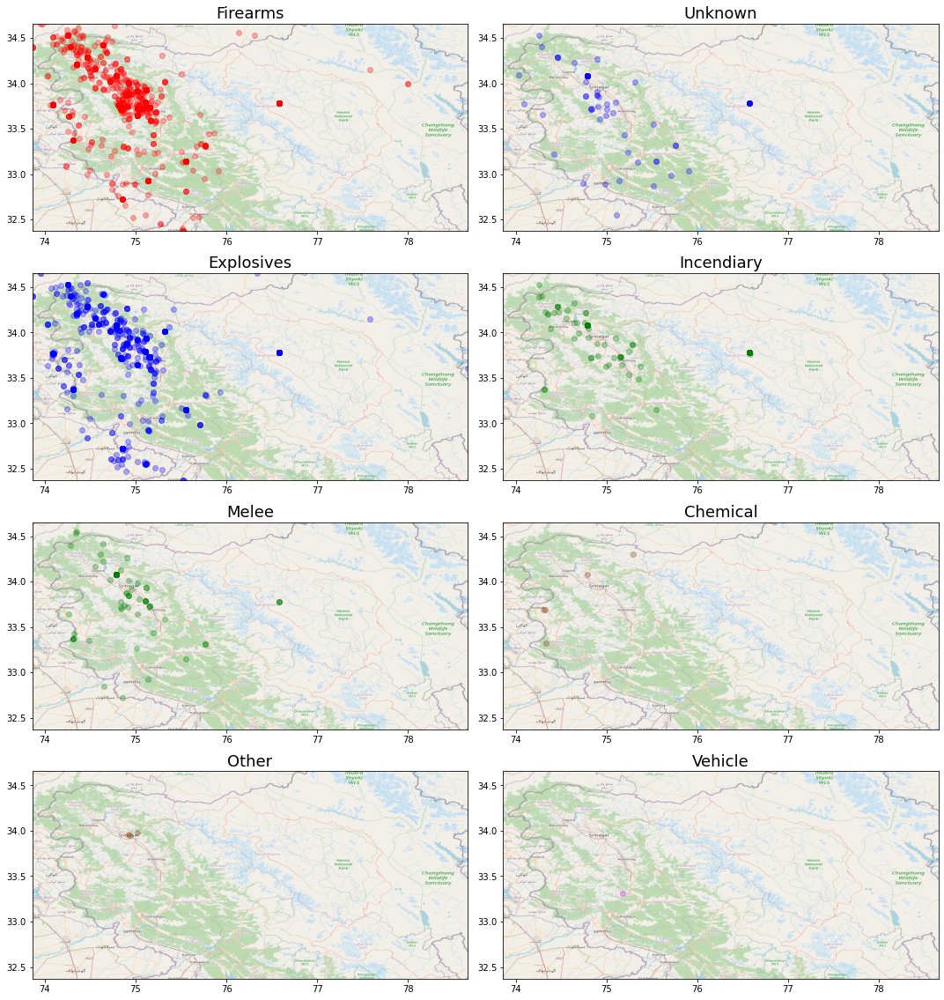

In [170]:
fig, ax = plt.subplots(4, 2, figsize=(15,16)) 
color = ['r', 'b', 'g', '#8a3801', 'm', 'k', '#017585', '#e75480',]
c = 0
row = col = 0
for i in df1.weaptype1_txt.unique():
    loc(df1[(df1.weaptype1_txt==i)], color[c], i, ax[row][col])
    if col:
        row+=1
        col = 0
        continue
    col+=1
    c+=1

## Conclusion
 - Most of the attacks are executed with Firearms. The most common weapon.
 - Attacks with explosives are concentrated in Kupwara district, Sopore, Srinagar and near India-Pakistan border.
 - Almost 90% of attacks are executed with firearms and explosives
 - In which 45% of attacks are independently executed by these weapons

# Analysis of success and location

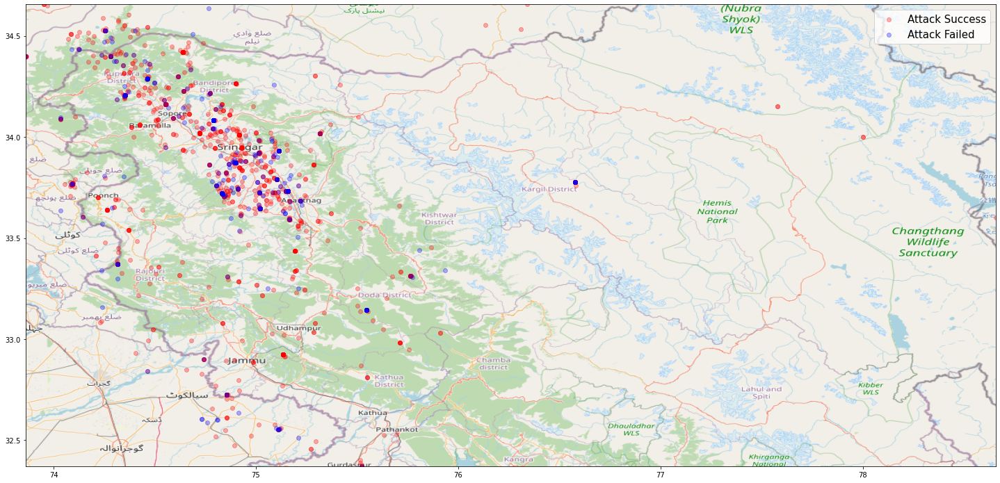

In [171]:
# Plotting locations where attacks were suceessful and failed

fig, ax = plt.subplots(figsize=(25,20))
color = ['r', 'b']
c = 0
BBox = ((df1.longitude.min(),   df1.longitude.max(),      
         df1.latitude.min(), df1.latitude.max()))
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])
jk = plt.imread('map.png')
for i in [1, 0]:
    temp = df1[(df1.success==i)]
    ax.scatter(temp.longitude, temp.latitude, alpha=0.3 , c=color[c])
    ax.legend(['Attack Success', 'Attack Failed'], prop={'size': 15})
    ax.imshow(jk, extent = BBox)
    c+=1

# Analysis of terrorist organisation and location

### Plotting where and which terrorist organisation is active

In [172]:
len(df1.gname.unique())

65

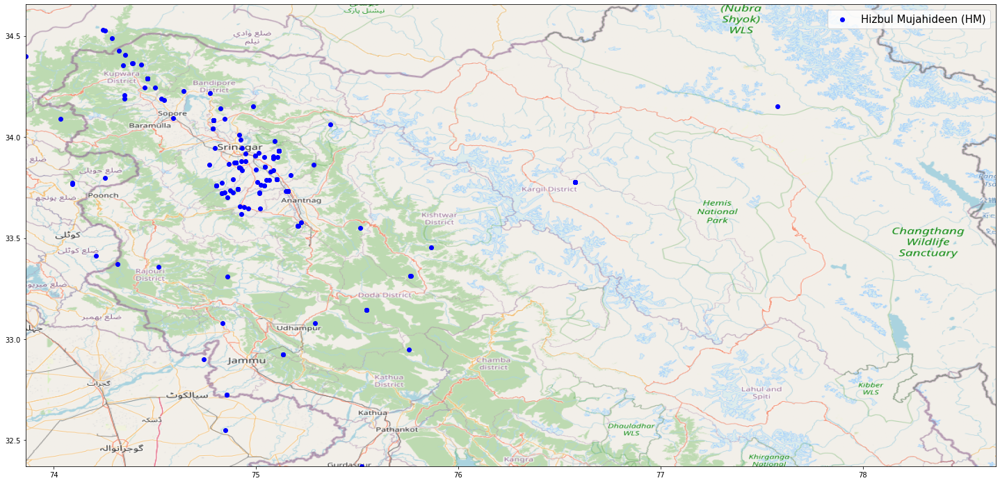

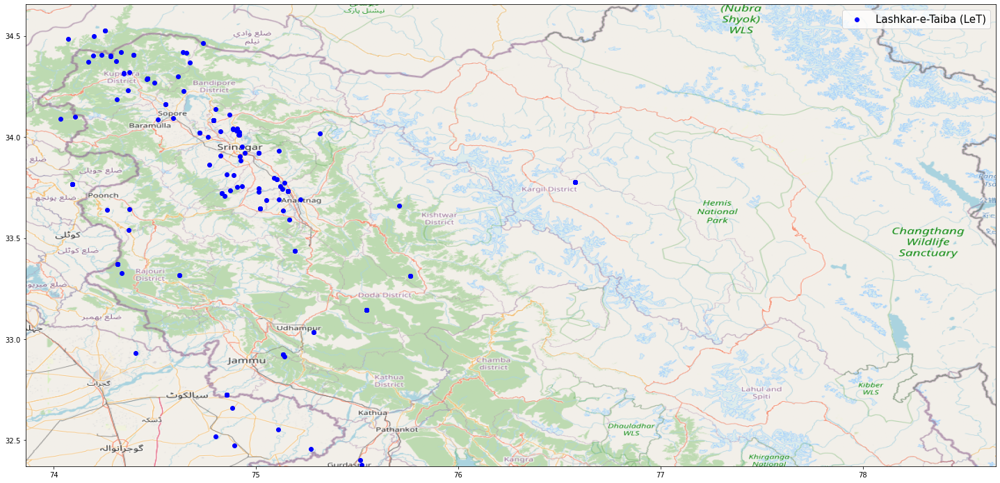

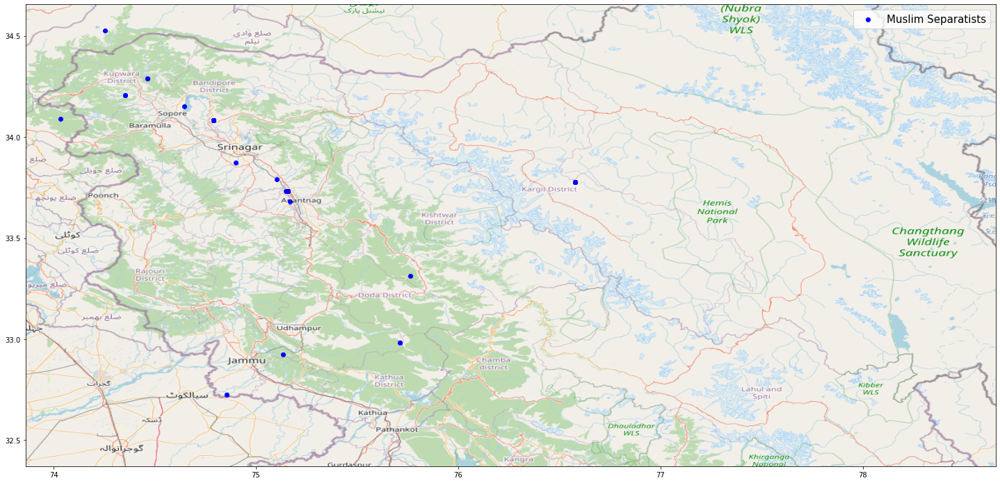

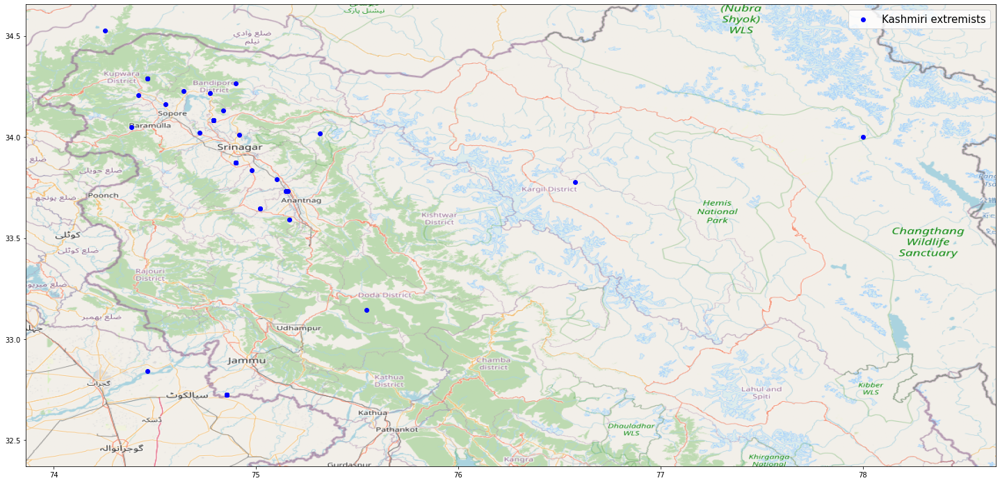

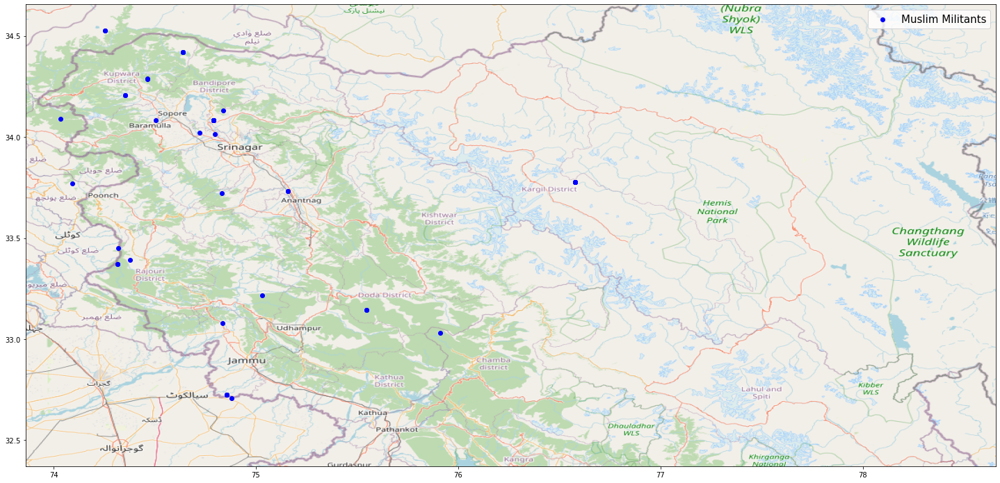

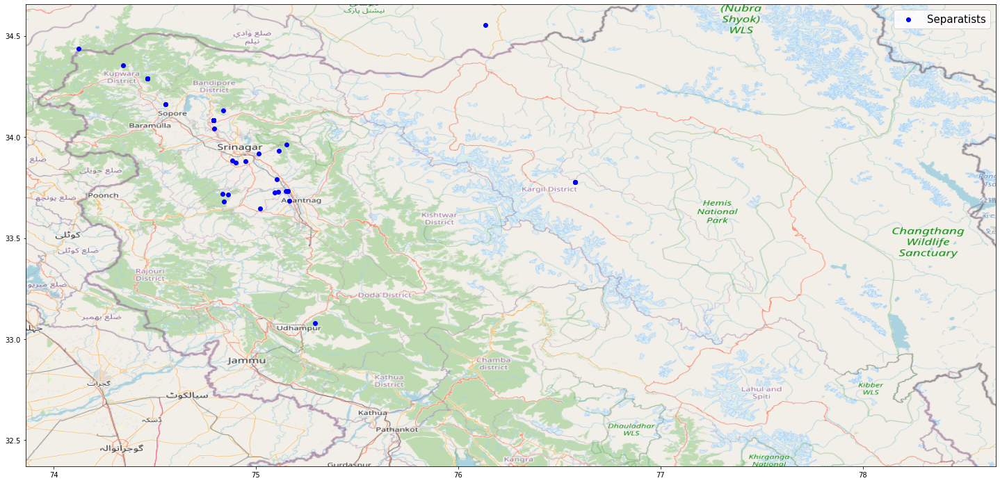

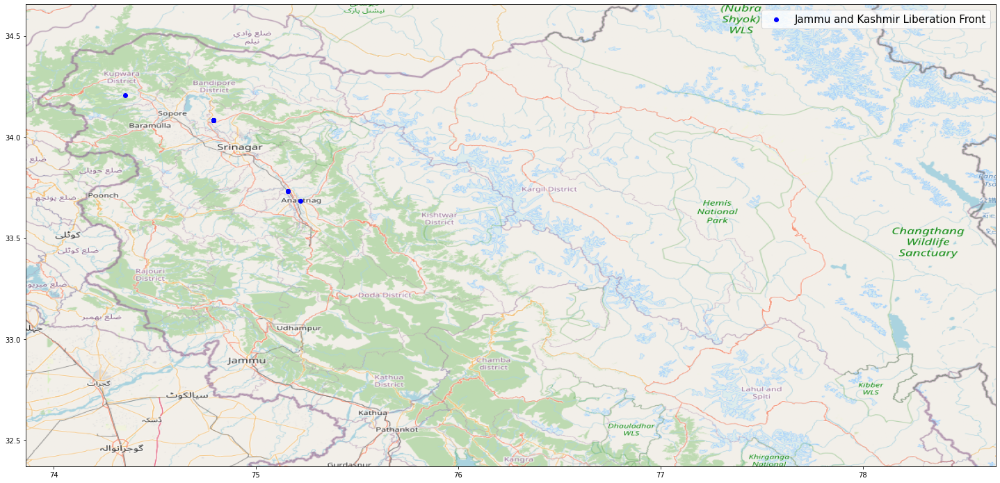

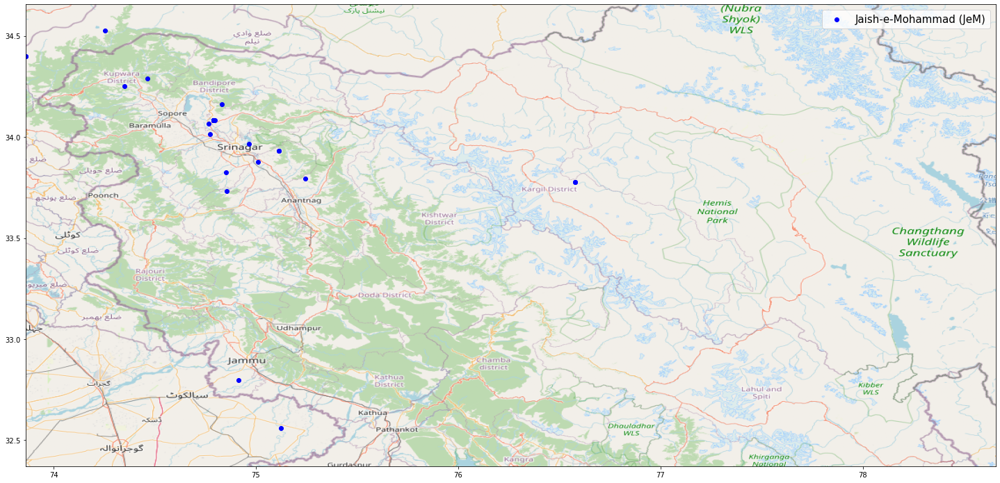

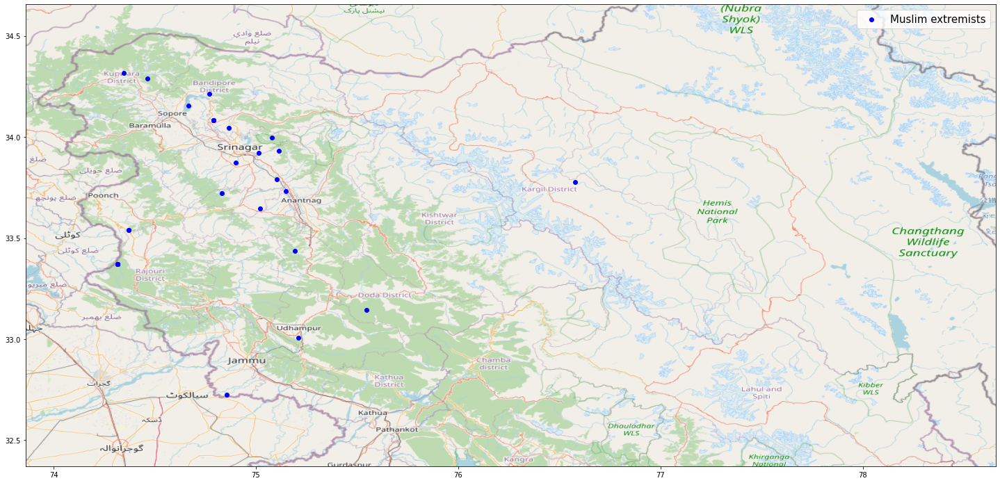

In [173]:
c = 0
BBox = ((df1.longitude.min(),   df1.longitude.max(),      
         df1.latitude.min(), df1.latitude.max()))
jk = plt.imread('map.png')
for i in df1.gname.value_counts()[:10].index:
    if i=='Unknown':
        continue
    temp = df1[(df1.gname==i)]
    plt.figure(figsize=(25,20))     
    plt.xlim(BBox[0],BBox[1])
    plt.ylim(BBox[2],BBox[3])
    plt.scatter(temp.longitude, temp.latitude, alpha=1 , c='b')
    plt.legend([i], prop={'size': 15})
    plt.imshow(jk, extent = BBox)   
    plt.show()
    c+=1

## Conclusion
 - Hizbul Mujahideen is mainly targetting Srinagar and Sopore
 - Lashkar-e-Taiba is mainly targetting Srinagar
 - Jaish-e-Mohammad is also targetting Srinagar
 - Almost all other seperatist are targetting Srinagar

# Analysis of number of fatalities and injuries over the year

In [174]:
fati = df1[['nkill', 'nwound', 'iyear', 'nkillter', 'nwoundte']]
fati.head()

,nkill,nwound,iyear,nkillter,nwoundte
3,2.0,0.0,1988,NaN,NaN
4,4.0,5.0,1988,NaN,NaN
5,3.0,0.0,1988,NaN,NaN
6,4.0,0.0,1988,NaN,NaN
7,0.0,0.0,1988,0.0,0.0


In [175]:
g = fati.groupby(by='iyear').sum()
g.head()

,nkill,nwound,nkillter,nwoundte
iyear,,,,
1988,36.0,81.0,0.0,0.0
1989,37.0,132.0,0.0,0.0
1990,194.0,55.0,0.0,0.0
1991,114.0,227.0,1.0,0.0
1992,168.0,148.0,0.0,0.0


In [176]:
g.index

Int64Index([1988, 1989, 1990, 1991, 1992, 1994, 1995, 1996, 1997, 1998, 1999,
            2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010,
            2011, 2012, 2013, 2014, 2015, 2016, 2017],
           dtype='int64', name='iyear')

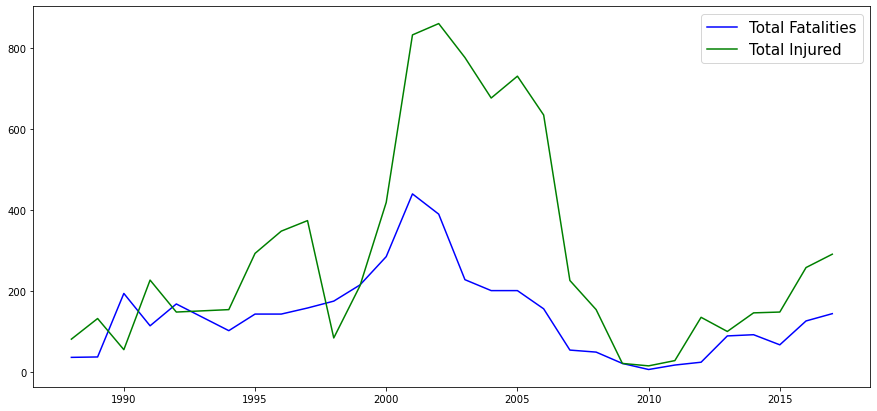

In [177]:
plt.figure(figsize=(15, 7))
plt.plot( g.index, g.nkill, color='b')
plt.plot( g.index, g.nwound, color='g')
plt.legend(['Total Fatalities', 'Total Injured'], prop={'size':15})

# Conclusion 
 - In almost every attack the number of injuries is more than number of fatalities.
 - The huge difference in injuries and fatalities are seen between 2000 to 2010.
 - But why? On 9th january 2001 a bomb was set off at the gate of the Central Telegraph Office in Srinagar.Many such attacks are organised in this decade the aim of which is to terrorise the local population.
 - The terrorist always work on the principle of "Kill one and terrorize thousands".

# Analysis of terrorist organisation and weapon they use

### Plotting which weapon is used by which organisation

In [178]:
df1.gname.value_counts()[1:16]

Hizbul Mujahideen (HM)                193
Lashkar-e-Taiba (LeT)                 165
Muslim Separatists                    113
Kashmiri extremists                    73
Muslim Militants                       70
Separatists                            51
Jammu and Kashmir Liberation Front     50
Jaish-e-Mohammad (JeM)                 31
Muslim extremists                      27
Militants                              23
Sikh Extremists                        19
Al-Mansoorian                          16
Lashkar-e-Islam (India)                13
Tehrik al-Mojahedin                    13
Jamiat ul-Mujahedin (JuM)              12
Name: gname, dtype: int64

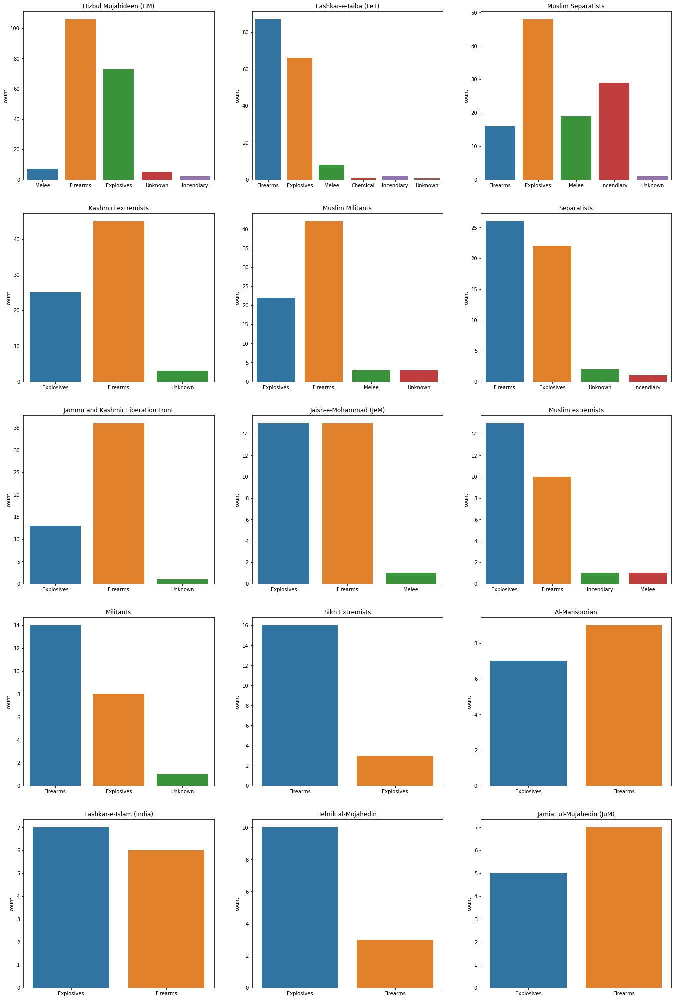

In [179]:
fig, ax = plt.subplots(5,3, figsize=(15,7))
row = 0
col = 0
for org in df1.gname.value_counts()[1:16].index:
    plt.subplots_adjust(left=0.3, right=1.5, top = 4)
    sns.countplot(df1[df1.gname==org].weaptype1_txt, ax = ax[row][col]).set(title=org, xlabel=None)
    plt.xlabel('')
    if col==2:
        row+=1
        col = 0
        continue
    col+=1

# Conclusion
 - Hizbul mujahideen and Lashkar-e-Taiba generally uses firearms and explosives.
 - If melee is used in attack then the attack would be executed by other militants not by Kashmiri extrimists.
 - Jaish-e-Mohammad uses only explosive, firearms and melee. They uses both firearms and explosives equally.
 - Extremities mainly uses firearms.
 - That means if attack is executed mainly with firearms then we will find the most active group in that region and create a list of possible groups. For example if attack was executed with firearm and explosive then we can say the group behind the attack may be Hizbul Mujahideen or Lashkar-e-taiba.
 - If we summarize then mostly all the groups have firearm as common weapon.    

# Analysis of terrorist organisation and their target

### Which terrorist organisation is targeting which sector

In [180]:
df1.gname.value_counts()[1:16]

Hizbul Mujahideen (HM)                193
Lashkar-e-Taiba (LeT)                 165
Muslim Separatists                    113
Kashmiri extremists                    73
Muslim Militants                       70
Separatists                            51
Jammu and Kashmir Liberation Front     50
Jaish-e-Mohammad (JeM)                 31
Muslim extremists                      27
Militants                              23
Sikh Extremists                        19
Al-Mansoorian                          16
Lashkar-e-Islam (India)                13
Tehrik al-Mojahedin                    13
Jamiat ul-Mujahedin (JuM)              12
Name: gname, dtype: int64

In [181]:
len(df1.targtype1_txt.unique())

19

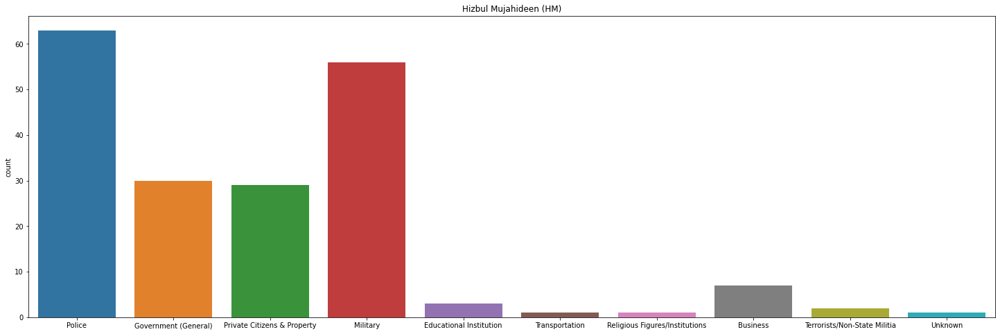

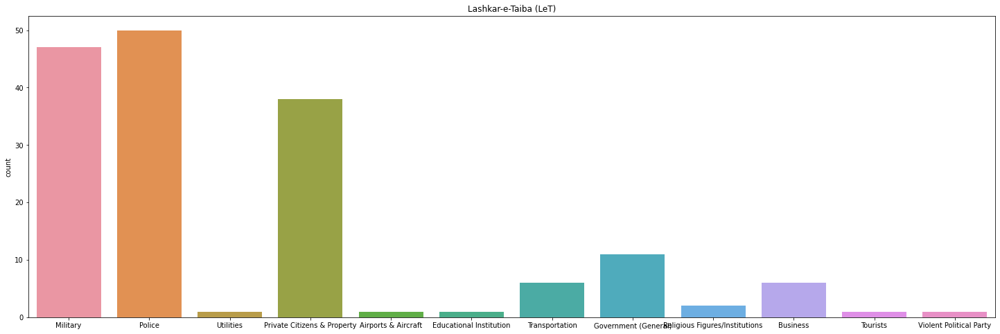

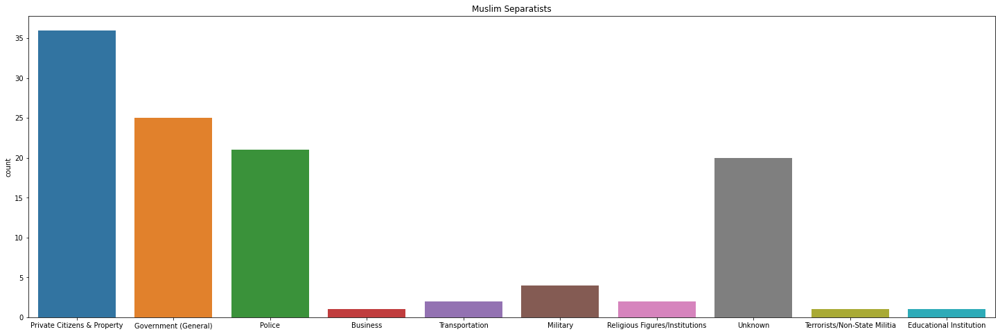

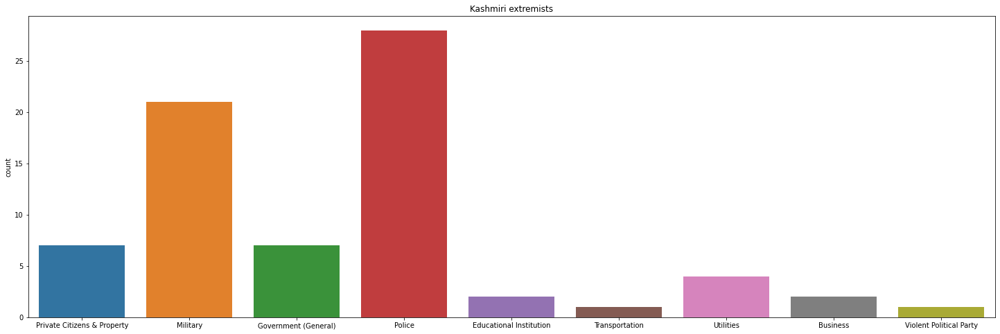

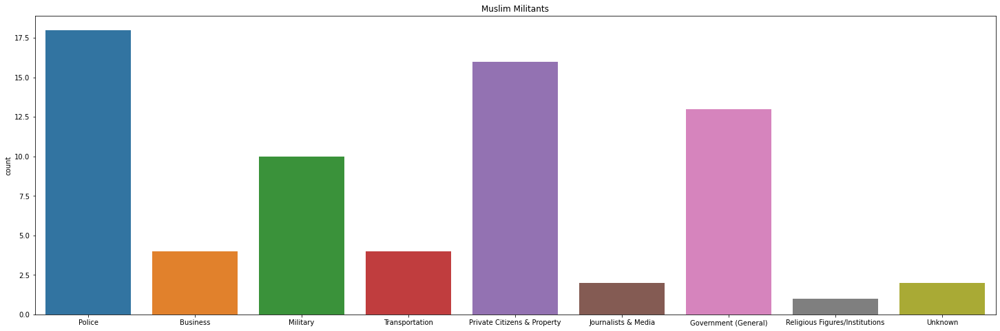

...

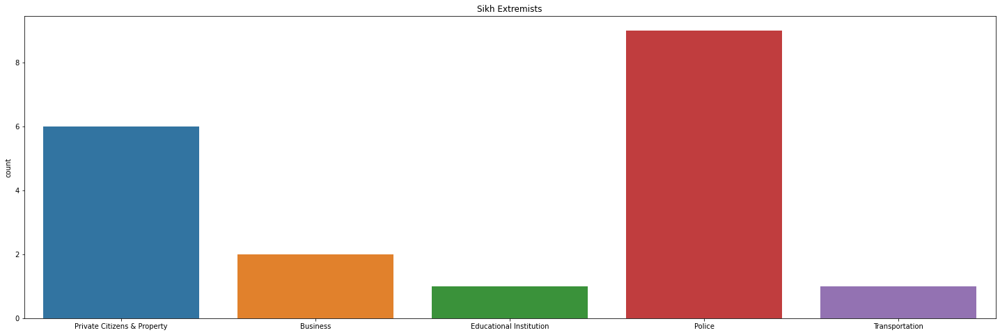

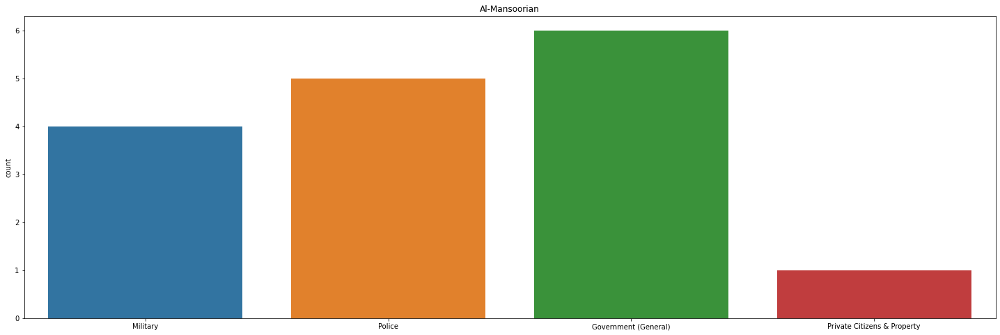

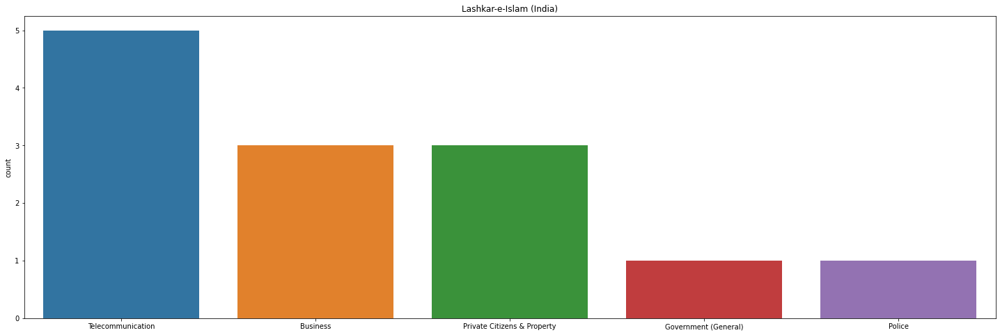

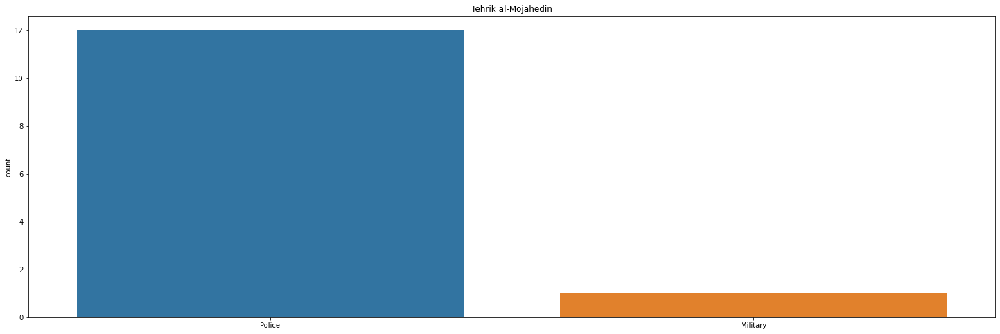

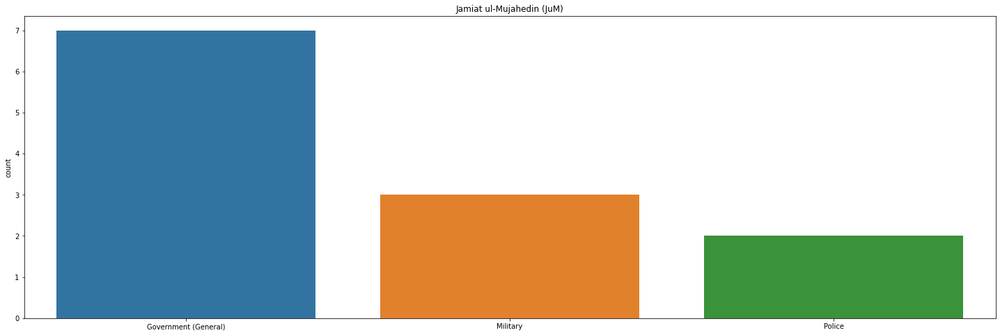

In [182]:
row = 0
col = 0
for org in df1.gname.value_counts()[1:16].index:
    fig, ax = plt.subplots(figsize=(25,8))
    sns.countplot(df1[df1.gname==org].targtype1_txt).set(title=org, xlabel=None)
    plt.show()

# Conclusion
 - Police and military are the favourite target for Hizbul Mujahideen.
 - Police, military and citizen are targetted by Lashkar-e-Taiba.
 - Kashmiri extrimists targets police and military.
 - Seperatists targets police.
 - Jammu and Kashmir libration front targets police and bussiness.
 - Jaish-e-mohammad targets police and military.
 - These informations are helpful to identify organisation behind the attack.
 - For example if attack is on military then we can create a list of organisation who targets military. So that we can advance our investigation.

# Analysis of weapon used to attack the target

### Which weapon is used to attack which target 

In [183]:
df1.weaptype1_txt.unique()

array(['Firearms', 'Unknown', 'Explosives', 'Incendiary', 'Melee',
       'Chemical', 'Other', 'Vehicle'], dtype=object)

In [184]:
df1.targtype1_txt.unique()

array(['Police', 'Private Citizens & Property', 'Business',
       'Transportation', 'Government (General)', 'Military',
       'Educational Institution', 'Tourists',
       'Religious Figures/Institutions', 'Violent Political Party',
       'Airports & Aircraft', 'Journalists & Media', 'Telecommunication',
       'Government (Diplomatic)', 'Terrorists/Non-State Militia',
       'Unknown', 'Utilities', 'NGO', 'Food or Water Supply'],
      dtype=object)

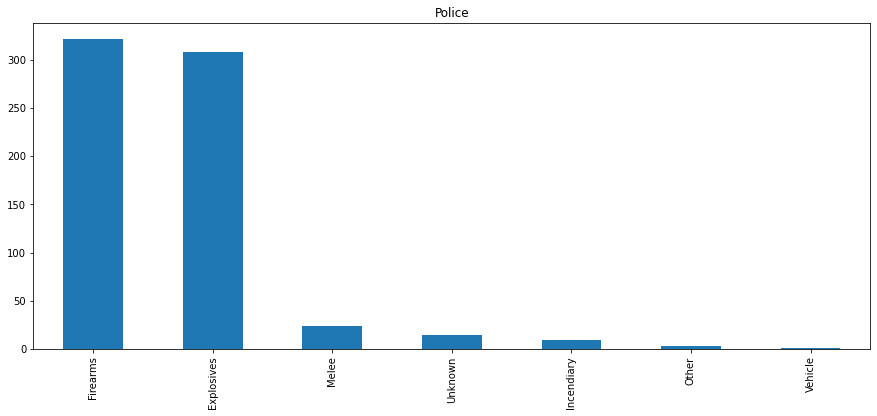

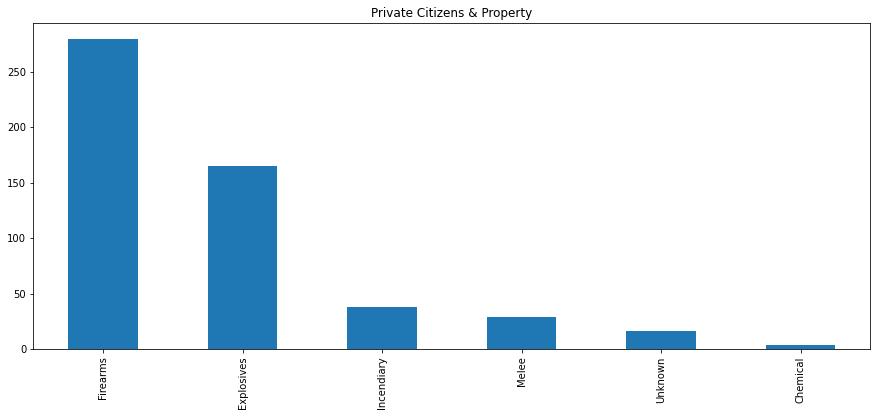

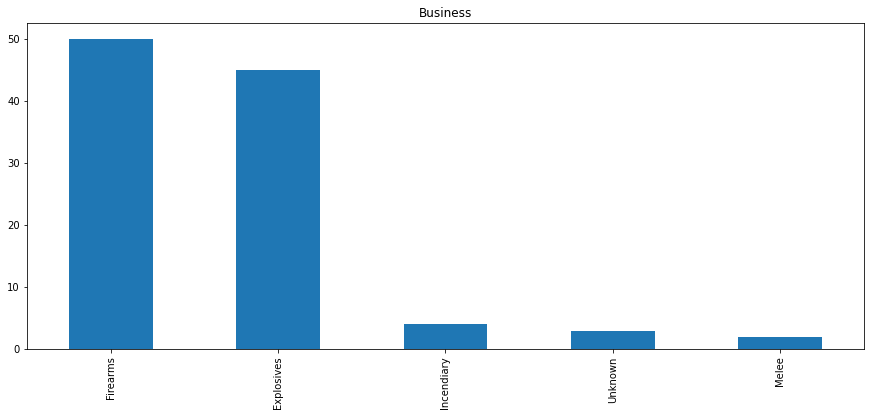

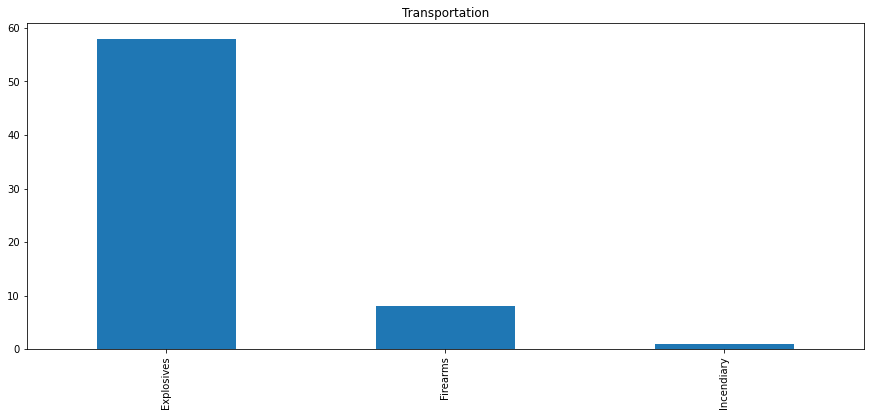

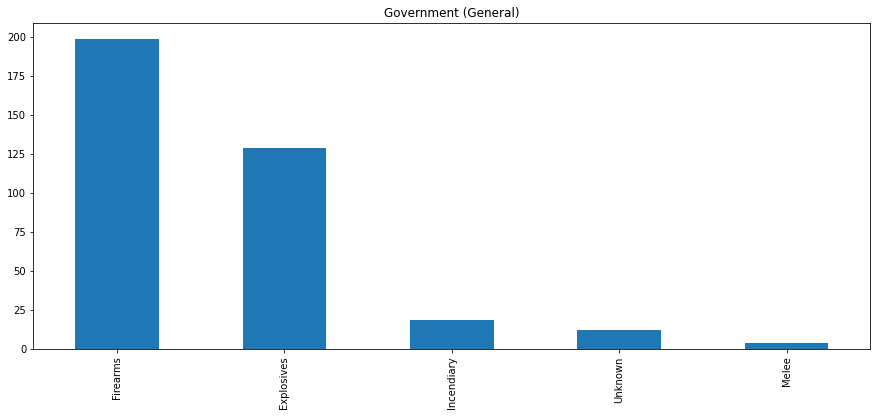

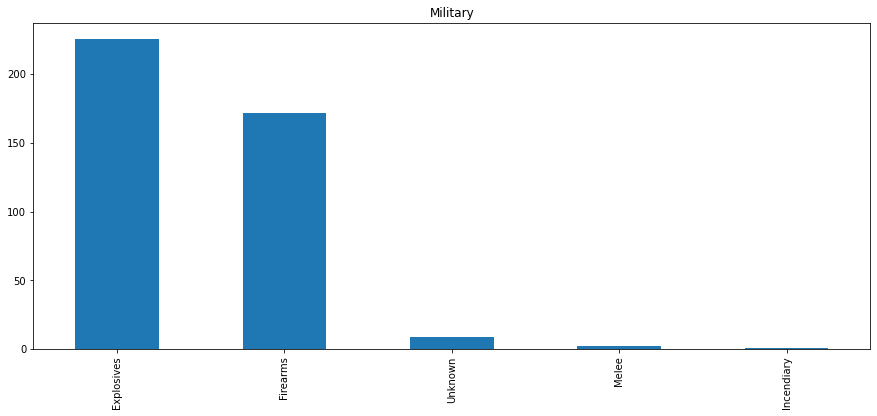

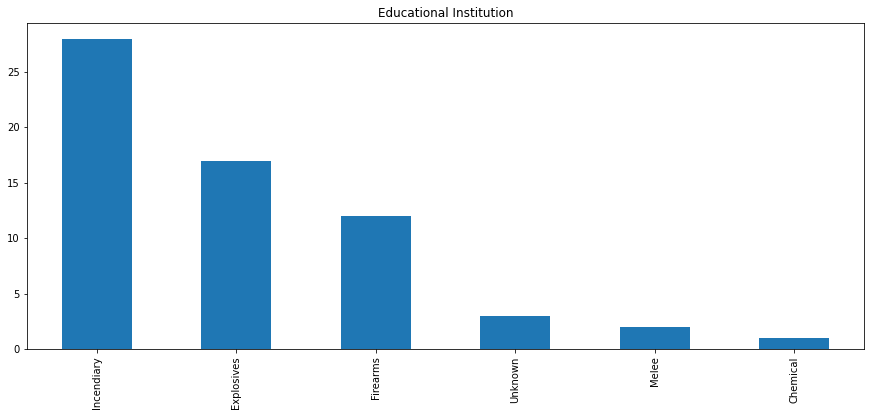

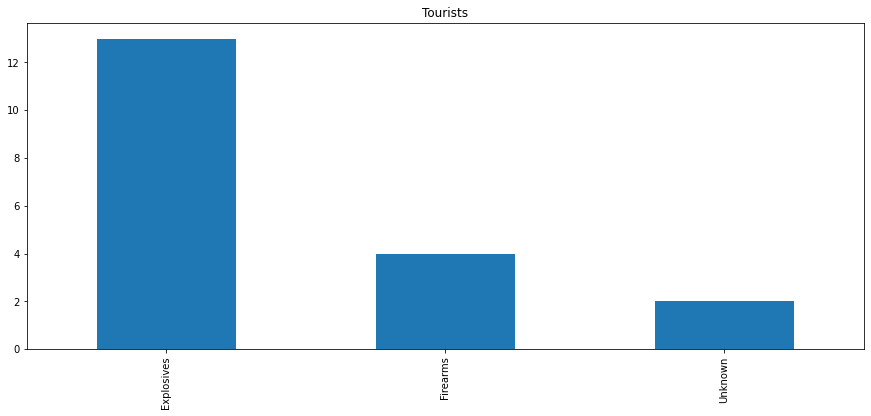

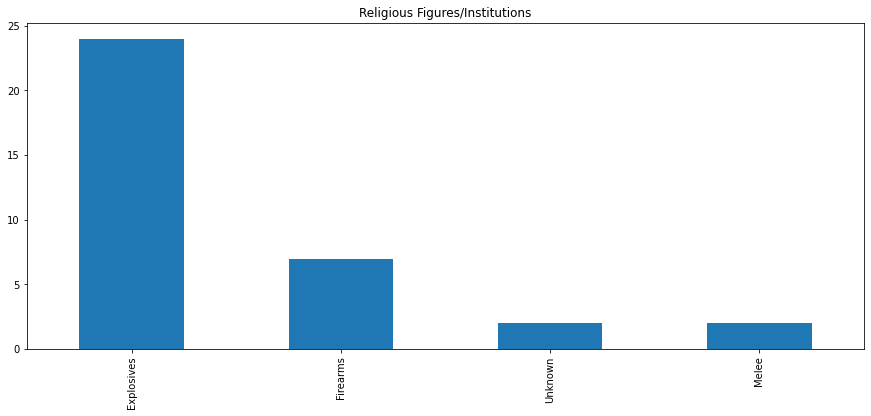

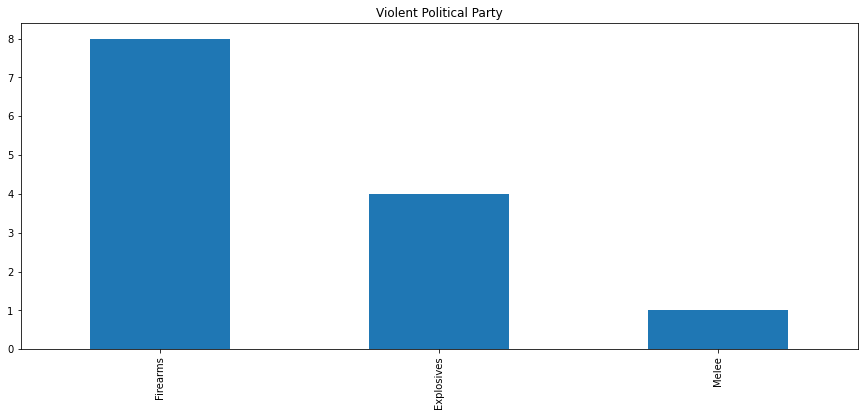

In [185]:
for target in df1.targtype1_txt.unique()[:10]:
    plt.figure(figsize=(15,6))
    df1[df1.targtype1_txt==target].weaptype1_txt.value_counts().plot.bar()
    plt.title(target)
    plt.show()

# Conclusion
 - To attack on police, organistion uses firearms and explosives in adequate amount.
 - To attack private citizen and property, firearms and explosives are the choise of terrorist.
 - To attack on bussiness they use firearms, explosive and incendiaries.
 - To attack on transportation explosives are the popular option.
 - To attack on firearms with explosives are used.
 - To attack on military explosives with firearms are used.
 - To attack on educational institutions incendiaries and explosives are mainly used.
 - These information are used to identify the targets.
 - For example - if some perpetrators are identified with incendiaries and explosives. Then what could be their target? Its an educational institution.

<br>

# <center><u><a id='pred'>Predictive Analysis</a></u>

1. Unknowns are treated as null values
2. The list valid_cols will store the name of all the required variables.
3. To maintain the consistency in the data we will fill NA values with -1
5. Since data is highly unbalanced so we need to use oversampling or undersampling
6. We will use tree-based model to predict group name and the success. But why tree-based model? 
     - Because they deconstruct the problem in pieces instead of finding one complex boundry like SVM or logistic regression. 
     - They split the feature space along various features to optimize the information.
     - They can handle null values.
7. We will use confusion matrix to evaluate our model. With the use of confusion matrix we will find precision, recall and F1-score.
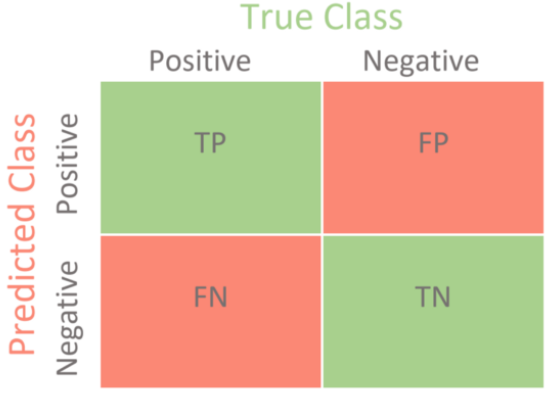

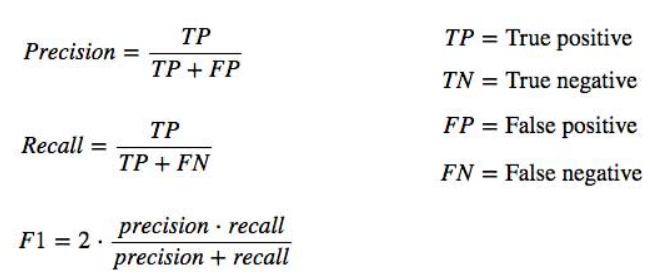

## <a id='prep'>Data Preprocessing</a>

#### We are going to use only data after 1997

In [186]:
# ML Data original
valid_cols = ['imonth','extended','crit1','crit2','crit3','doubtterr', 'longitude', 'latitude',
              'attacktype1','success','suicide','weaptype1','weapsubtype1','targtype1','targsubtype1','gname',
              'nperps','nperpcap','claimed','nkill','nkillter','nwound','nwoundte','property','ishostkid',
              'hostkidoutcome', 'city', 'weaptype1_txt', 'targtype1_txt', 'attacktype1_txt']
mldo = df[valid_cols]
mldo.head()

,imonth,extended,crit1,crit2,crit3,doubtterr,longitude,latitude,attacktype1,success,...,nkillter,nwound,nwoundte,property,ishostkid,hostkidoutcome,city,weaptype1_txt,targtype1_txt,attacktype1_txt
0,1,0,1,1,1,0,76.576171,33.778175,2,1,...,0.0,NaN,0.0,1,0,NaN,Wandhama,Melee,Private Citizens & Property,Armed Assault
1,4,0,1,1,1,0,74.730781,33.200294,2,1,...,0.0,NaN,NaN,1,0,NaN,Thub,Firearms,Private Citizens & Property,Armed Assault
2,4,0,1,1,1,0,75.135264,32.925224,2,1,...,0.0,NaN,NaN,1,0,NaN,Udhampur district,Firearms,Private Citizens & Property,Armed Assault
3,5,0,1,1,1,0,74.263416,33.639869,2,1,...,0.0,0.0,0.0,0,0,NaN,Surankot,Firearms,Private Citizens & Property,Armed Assault
4,5,0,1,1,1,0,75.548049,33.145750,2,1,...,0.0,0.0,0.0,0,0,NaN,Doda district,Firearms,Private Citizens & Property,Armed Assault


In [187]:
# Perecntage of null values present
((mldo.isna().sum()[mldo.isna().sum()>0]/len(mldo))*100).astype(str).str[:4]

weapsubtype1      2.70
targsubtype1      4.58
nperps            37.5
nperpcap          7.89
nkill             0.66
nkillter          1.60
nwound            3.69
nwoundte          4.08
hostkidoutcome    95.0
dtype: object

In [188]:
# Replacing null and unknown values with -1

mldo.imonth.replace(0, -1, inplace=True)
mldo.attacktype1.replace(9, -1, inplace=True)
mldo.weaptype1.replace(13, -1, inplace=True)
mldo.weapsubtype1.replace(5, -1, inplace=True)
mldo.weapsubtype1.replace(16, -1, inplace=True)
mldo.weapsubtype1.replace(27, -1, inplace=True)
mldo.targtype1.replace(20, -1, inplace=True)
mldo.nperps.replace(-99, -1, inplace=True)
mldo.nperpcap.replace(-99, -1, inplace=True)
mldo.property.replace(-9, -1, inplace=True)
mldo.ishostkid.replace(-9, -1, inplace=True)
mldo.hostkidoutcome.replace(7, -1, inplace=True)
mldo.claimed.replace(-9, -1, inplace=True)
mldo.fillna(value=-1, inplace=True)

In [189]:
mldo.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1811 entries, 0 to 1810
Data columns (total 30 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   imonth           1811 non-null   int64  
 1   extended         1811 non-null   int64  
 2   crit1            1811 non-null   int64  
 3   crit2            1811 non-null   int64  
 4   crit3            1811 non-null   int64  
 5   doubtterr        1811 non-null   int64  
 6   longitude        1811 non-null   float64
 7   latitude         1811 non-null   float64
 8   attacktype1      1811 non-null   int64  
 9   success          1811 non-null   int64  
 10  suicide          1811 non-null   int64  
 11  weaptype1        1811 non-null   int64  
 12  weapsubtype1     1811 non-null   float64
 13  targtype1        1811 non-null   int64  
 14  targsubtype1     1811 non-null   float64
 15  gname            1811 non-null   object 
 16  nperps           1811 non-null   float64
 17  nperpcap      

In [190]:
# Converting data to required data type
mldo['weapsubtype1'] =  mldo.weapsubtype1.astype(np.int64)
mldo['targsubtype1'] =  mldo.targsubtype1.astype(np.int64)
mldo['nperps'] =  mldo.nperps.astype(np.int64)
mldo['nperpcap'] =  mldo.nperpcap.astype(np.int64)
mldo['nkill'] =  mldo.nkill.astype(np.int64)
mldo['nkillter'] =  mldo.nkillter.astype(np.int64)
mldo['nwound'] =  mldo.nwound.astype(np.int64)
mldo['nwoundte'] =  mldo.nwoundte.astype(np.int64)
mldo['hostkidoutcome'] =  mldo.hostkidoutcome.astype(np.int64)

In [191]:
mldo.describe().loc['max']

imonth             12.000000
extended            1.000000
crit1               1.000000
crit2               1.000000
crit3               1.000000
doubtterr           1.000000
longitude          78.656086
latitude           34.655639
attacktype1         8.000000
success             1.000000
suicide             1.000000
weaptype1          12.000000
weapsubtype1       24.000000
targtype1          22.000000
targsubtype1      113.000000
nperps             30.000000
nperpcap           11.000000
claimed             1.000000
nkill              35.000000
nkillter           15.000000
nwound            100.000000
nwoundte            5.000000
property            1.000000
ishostkid           1.000000
hostkidoutcome      6.000000
Name: max, dtype: float64

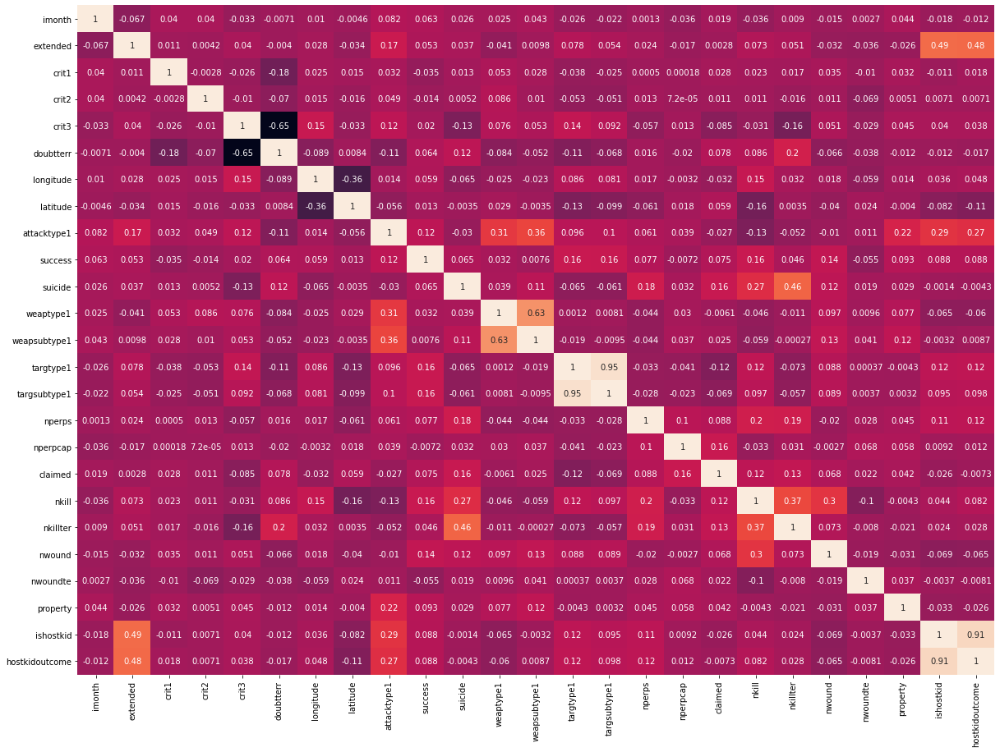

In [192]:
plt.figure(figsize=(20,15))
sns.heatmap(mldo.corr(), annot=True, cbar=False)

In [193]:
df = mldo.drop(['city','weaptype1_txt', 'targtype1_txt', 'attacktype1_txt'], axis=1)

# Model Preprocessing Template

### Here I have just created some functions to perform repetitive tasks.

In [194]:
def normalize(trainx, testx, to_normalise):
    '''
    Normalise the data
    '''
    normalizer = Normalizer().fit(trainx[to_normalise])
    trainx[to_normalise] = normalizer.transform(trainx[to_normalise])
    testx[to_normalise] = normalizer.transform(testx[to_normalise])
    return trainx,testx, normalizer

In [195]:
def predict(model, clr=0, mat=0):
    '''
    This function will provide us infomation about how our model is performing 
    '''
    print(f"True: {testy.loc[[testy[:1].index[0]]]}")

    print(f"\nPredicted: {model.predict(testx.loc[[testy[:1].index[0]]])[0]}")
    
    print(f'''\n\n Precision: {precision(testy, model.predict(testx), average='weighted')}
                \n Recall: {recall(testy, model.predict(testx), average='weighted')}
                \n F1 Score: {f1(testy, model.predict(testx), average='weighted')}''')
    
    if clr:
        print('\n\nClassification report - \n',report(testy, model.predict(testx)))
    
    if mat:
        plt.figure(figsize=(15, 8))
        sns.heatmap(confusion(testy, model.predict(testx)), annot=True,cmap='Blues', cbar=False)

In [196]:
def model(trainx, testx, trainy, testy, ret=0):
    
    '''
    This function will train various model and return those
    '''
    
    try:
        dtcm = dtc(max_depth=3,  random_state=1005)
        dtcm.fit(trainx, trainy)
        print(f'Decision tree:\nTraining Score: {dtcm.score(trainx, trainy)}\nTesting Score:{dtcm.score(testx, testy)}\n\n')
    except Exception as E:
        print('Decision Tree: ', E)
        print()
        dtcm=None
    try:
        rfm = rf(max_depth=3,  random_state=1005)
        rfm.fit(trainx, trainy)
        rfm.score(trainx, trainy), rfm.score(testx, testy)
        print(f'Random Forest:\nTraining Score: {rfm.score(trainx, trainy)}\nTesting Score:{rfm.score(testx, testy)}\n\n')
    except Exception as E:
        print('Random Forest: ', E)
        print()
        rfm=None    
    try:
        knnm = knn()
        knnm.fit(trainx, trainy)
        knnm.score(trainx, trainy), knnm.score(testx, testy)
        print(f'KNN:\nTraining Score: {knnm.score(trainx, trainy)}\nTesting Score:{knnm.score(testx, testy)}\n\n')
    except Exception as E:
        print('KNN: ', E)
        print()
        knnm=None
    try:
        lda = LDA()
        lda.fit(trainx, trainy)
        lda.score(trainx, trainy), lda.score(testx, testy)
        print(f'LDA:\nTraining Score: {lda.score(trainx, trainy)}\nTesting Score:{lda.score(testx, testy)}\n\n')
    except Exception as E:
        print('LDA: ', E)
        print()
        lda=None
    try:
        xgbm = xgb.XGBClassifier(n_estimators=5, missing=-1, random_state=1005)
        xgbm.fit(trainx, trainy)
        xgbm.score(trainx, trainy), xgbm.score(testx, testy)
        print(f'XGB:\nTraining Score: {xgbm.score(trainx, trainy)}\nTesting Score:{xgbm.score(testx, testy)}\n\n')
    except Exception as E:
        print('XGB: ', E)
        print()
        xgbm=None
        
    if ret:
        return dtcm, rfm, knnm, lda, xgbm

<br>

# 1. <a id='1'>Predicting group name after attack</a>

If the attack is executed at particular location then we are trying to indentify the organistion behind the attack. So that we can advance our investigation in that direction

In [197]:
x = df.drop(['gname', 'claimed'], axis=1)
y = df.gname
trainx, testx, trainy, testy  = train_test_split(x, y, test_size=0.2, random_state=1005)

In [198]:
to_normalise = ['nwoundte', 'nwound', 'nkillter', 'nkill', 'nperpcap', 'nperps']

trainx, testx, n = normalize(trainx, testx, to_normalise)

dtcm, rfm, knnm, lda, xgbm = model(trainx, testx, trainy, testy, 1)

Decision tree:
Training Score: 0.6892265193370166
Testing Score:0.6749311294765841


Random Forest:
Training Score: 0.68646408839779
Testing Score:0.6831955922865014


KNN:
Training Score: 0.712707182320442
Testing Score:0.6143250688705234


LDA:
Training Score: 0.6671270718232044
Testing Score:0.6363636363636364


XGB:
Training Score: 0.7569060773480663
Testing Score:0.6831955922865014




In [199]:
predict(rfm)

True: 722    Unknown
Name: gname, dtype: object

Predicted: Unknown


 Precision: 0.5329216449120223
                
 Recall: 0.6831955922865014
                
 F1 Score: 0.5623771171633906


## Finding important features

In [200]:
rfm.feature_importances_

array([0.01719295, 0.01153225, 0.        , 0.        , 0.00462505,
       0.00199948, 0.01457581, 0.02200855, 0.03390893, 0.01916726,
       0.09225287, 0.01292182, 0.01463641, 0.02669671, 0.04508878,
       0.2661565 , 0.03733717, 0.11898863, 0.16930186, 0.03349371,
       0.00483613, 0.01143999, 0.01307423, 0.02876491])

In [201]:
cols = x.columns[rfm.feature_importances_>0.10].tolist()
print(cols)

['nperps', 'nkill', 'nkillter']


In [202]:
# Using only important features
x = df[cols]
y = df.gname
trainx, testx, trainy, testy  = train_test_split(x, y, test_size=0.2, random_state=1005)

In [203]:
to_normalise = ['nperps', 'nkill', 'nkillter']

trainx, testx, n = normalize(trainx, testx, to_normalise)

dtcm, rfm, knnm, lda, xgbm = model(trainx, testx, trainy, testy, 1)

Decision tree:
Training Score: 0.6899171270718232
Testing Score:0.6942148760330579


Random Forest:
Training Score: 0.6892265193370166
Testing Score:0.6942148760330579


KNN:
Training Score: 0.649171270718232
Testing Score:0.6584022038567493


LDA:
Training Score: 0.6671270718232044
Testing Score:0.6831955922865014


XGB:
Training Score: 0.6982044198895028
Testing Score:0.6804407713498623




In [204]:
predict(dtcm)

True: 722    Unknown
Name: gname, dtype: object

Predicted: Unknown


 Precision: 0.5259316025694704
                
 Recall: 0.6942148760330579
                
 F1 Score: 0.5936219453954672


In [205]:
predict(rfm)

True: 722    Unknown
Name: gname, dtype: object

Predicted: Unknown


 Precision: 0.5245203722883331
                
 Recall: 0.6942148760330579
                
 F1 Score: 0.5926697243311664


In [206]:
predict(xgbm)

True: 722    Unknown
Name: gname, dtype: object

Predicted: Unknown


 Precision: 0.5105466428995841
                
 Recall: 0.6804407713498623
                
 F1 Score: 0.5779277580306741


## Oversampling

In [207]:
x = df[cols]
y = df.gname

In [208]:
ov = ROS(random_state=34)
x, y = ov.fit_resample(x, y)

In [209]:
trainx, testx, trainy, testy  = train_test_split(x, y, test_size=0.2, random_state=1005)

In [210]:
to_normalise = ['nperps', 'nkill', 'nkillter']

trainx, testx, n = normalize(trainx, testx, to_normalise)

dtcm, rfm, knnm, lda, xgbm = model(trainx, testx, trainy, testy, 1)

Decision tree:
Training Score: 0.09732750242954324
Testing Score:0.0892128279883382


Random Forest:
Training Score: 0.2552964042759961
Testing Score:0.24859086491739554


KNN:
Training Score: 0.3428328474246842
Testing Score:0.3408163265306122


LDA:
Training Score: 0.21209912536443148
Testing Score:0.2054421768707483


XGB:
Training Score: 0.3736880466472303
Testing Score:0.3675413022351798




In [211]:
predict(dtcm)

True: 49758    Tehrik-e-Hurriyat (TeH)
Name: gname, dtype: object

Predicted: Al-Nasireen Group


 Precision: 0.07080265306113592
                
 Recall: 0.0892128279883382
                
 F1 Score: 0.05694474155800834


## Undersampling

In [212]:
x = df[cols]
y = df.gname

In [213]:
ov = RUS(random_state=34)
x, y = ov.fit_resample(x, y)

In [214]:
trainx, testx, trainy, testy  = train_test_split(x, y, test_size=0.2, random_state=1005)

In [215]:
to_normalise = ['nperps', 'nkill', 'nkillter']

trainx, testx, n = normalize(trainx, testx, to_normalise)

dtcm, rfm, knnm, lda, xgbm = model(trainx, testx, trainy, testy, 1)

Decision tree:
Training Score: 0.12121212121212122
Testing Score:0.0


Random Forest:
Training Score: 0.45454545454545453
Testing Score:0.0


KNN:
Training Score: 0.09090909090909091
Testing Score:0.0


LDA:  The number of samples must be more than the number of classes.

XGB:
Training Score: 0.030303030303030304
Testing Score:0.0




In [216]:
predict(dtcm)

True: 40    United Jihad Council
Name: gname, dtype: object

Predicted: Al-Arifeen


 Precision: 0.0
                
 Recall: 0.0
                
 F1 Score: 0.0


<br>

# 2. <a id='2'>Predicting Success  - Simulation</a>

 - target - success

This model is for simulation, so that we can be prepared for any attack. For example we are given with the location of attack then we can find other parameters using analysis we have done before and can predict that to execute a successful attack organisation must have such combination of weapons or number of perpetrators.

In [217]:
temp = df.copy()
ready = temp.drop(['success', 'gname'], axis=1)
x = ready.copy()
y = temp.success
trainx, testx, trainy, testy  = train_test_split(x, y, test_size=0.2, random_state=1005)

In [218]:
to_normalise = ['nkill','nperps', 'nwound', 'nkillter', 'nwoundte', 'nperpcap']

trainx, testx, n = normalize(trainx, testx, to_normalise)

dtcm, rfm, knnm, lda, xgbm = model(trainx, testx, trainy, testy, 1)

Decision tree:
Training Score: 0.9136740331491713
Testing Score:0.9035812672176309


Random Forest:
Training Score: 0.8832872928176796
Testing Score:0.8677685950413223


KNN:
Training Score: 0.899171270718232
Testing Score:0.8457300275482094


LDA:
Training Score: 0.8888121546961326
Testing Score:0.8622589531680441


XGB:
Training Score: 0.9682320441988951
Testing Score:0.9421487603305785




In [219]:
predict(xgbm)

True: 722    1
Name: success, dtype: int64

Predicted: 1


 Precision: 0.9399336770382652
                
 Recall: 0.9421487603305785
                
 F1 Score: 0.9398788200265681


# Feature Seclection

In [220]:
xgbm.feature_importances_

array([0.00577629, 0.        , 0.        , 0.        , 0.        ,
       0.04435516, 0.00925062, 0.01659098, 0.07674786, 0.        ,
       0.02839277, 0.06528424, 0.01500319, 0.01903285, 0.25378284,
       0.02211718, 0.        , 0.13811527, 0.02305237, 0.01025318,
       0.02773512, 0.17237343, 0.07213666, 0.        ], dtype=float32)

In [221]:
# Using important features
cols = ready.columns[xgbm.feature_importances_.astype(bool)].tolist()
feat_col = cols.copy()
print(cols)

['imonth', 'doubtterr', 'longitude', 'latitude', 'attacktype1', 'weaptype1', 'weapsubtype1', 'targtype1', 'targsubtype1', 'nperps', 'nperpcap', 'nkill', 'nkillter', 'nwound', 'nwoundte', 'property', 'ishostkid']


In [222]:
x = ready[cols]
y = temp.success
trainx, testx, trainy, testy  = train_test_split(x, y, test_size=0.2, random_state=1005)

In [223]:
dtcm, rfm, knnm, lda, xgbm = model(trainx, testx, trainy, testy, 1)

Decision tree:
Training Score: 0.9067679558011049
Testing Score:0.8925619834710744


Random Forest:
Training Score: 0.8839779005524862
Testing Score:0.8705234159779615


KNN:
Training Score: 0.9019337016574586
Testing Score:0.8347107438016529


LDA:
Training Score: 0.856353591160221
Testing Score:0.859504132231405


XGB:
Training Score: 0.9571823204419889
Testing Score:0.9421487603305785




In [224]:
predict(xgbm)

True: 722    1
Name: success, dtype: int64

Predicted: 1


 Precision: 0.9404523705959112
                
 Recall: 0.9421487603305785
                
 F1 Score: 0.9386994431816601


In [225]:
predict(rfm)

True: 722    1
Name: success, dtype: int64

Predicted: 1


 Precision: 0.8710908702906142
                
 Recall: 0.8705234159779615
                
 F1 Score: 0.8271464462538274


## Oversampling

In [226]:
x = ready[cols]
y = temp.success

In [227]:
ov = ROS(random_state=34)
x, y = ov.fit_resample(x, y)

In [228]:
trainx, testx, trainy, testy  = train_test_split(x, y, test_size=0.2, random_state=1005)

In [229]:
dtcm, rfm, knnm, lda, xgbm = model(trainx, testx, trainy, testy, 1)

Decision tree:
Training Score: 0.8762636473918318
Testing Score:0.864297253634895


Random Forest:
Training Score: 0.8843509906995553
Testing Score:0.877221324717286


KNN:
Training Score: 0.9082086534573393
Testing Score:0.8529886914378029


LDA:
Training Score: 0.7201779215527699
Testing Score:0.7011308562197092


XGB:
Training Score: 0.9627982207844723
Testing Score:0.9450726978998385




In [230]:
predict(xgbm)

True: 805    1
Name: success, dtype: int64

Predicted: 1


 Precision: 0.9456263842157899
                
 Recall: 0.9450726978998385
                
 F1 Score: 0.9451028367309446


# 3. <a id=3>Predicting group name before attack</a>

Here we are trying to predict the expected group name before attack. For example we have an intelligence that perpetrators are seen with some weapons, other parameters are identified with the help of analysis done before. So which group is likely to execute this attack can be identified with this model.

In [231]:
df = mldo[['imonth', 'crit1', 'crit2', 'crit3', 'doubtterr', 'attacktype1', 'weaptype1', 'targtype1', 'gname']]

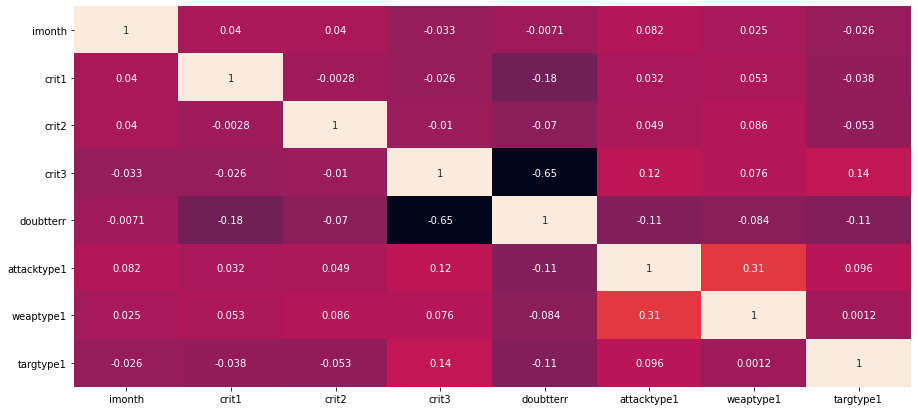

In [232]:
plt.figure(figsize=(15, 7))
sns.heatmap(df.corr(), cbar=0, annot=True)

In [233]:
x = df.drop('gname', axis=1)
y = df.gname
trainx, testx, trainy, testy = train_test_split(x, y, test_size=0.1, random_state=193)

In [234]:
pca = PCA(n_components=4)

pca.fit(trainx).explained_variance_ratio_

array([0.68851979, 0.21382773, 0.06135041, 0.03116936])

In [235]:
trainx = pca.transform(trainx)
testx = pca.transform(testx)

In [236]:
dtcm, rfm, knnm, lda, xgbm = model(trainx, testx, trainy, testy,1)

Decision tree:
Training Score: 0.6746470227133211
Testing Score:0.7032967032967034


Random Forest:
Training Score: 0.6734192756292203
Testing Score:0.7032967032967034


KNN:
Training Score: 0.6887661141804788
Testing Score:0.6648351648351648


LDA:
Training Score: 0.6642111724984653
Testing Score:0.6923076923076923


XGB:
Training Score: 0.6734192756292203
Testing Score:0.7032967032967034




In [237]:
print(report(testy, lda.predict(testx)))

                               precision    recall  f1-score   support

                   Al-Arifeen       0.00      0.00      0.00         1
                      Al-Badr       0.00      0.00      0.00         1
             Al-Shuda Brigade       0.00      0.00      0.00         1
           Al-Umar Mujahideen       0.00      0.00      0.00         1
        Ansar Ghazwat-ul-Hind       0.00      0.00      0.00         1
       Hizbul Mujahideen (HM)       0.00      0.00      0.00        16
                Islamic Fateh       0.00      0.00      0.00         1
       Jaish-e-Mohammad (JeM)       0.00      0.00      0.00         4
    Jamiat ul-Mujahedin (JuM)       0.00      0.00      0.00         2
      Lashkar-e-Islam (India)       0.00      0.00      0.00         2
            Lashkar-e-Jhangvi       0.00      0.00      0.00         0
        Lashkar-e-Taiba (LeT)       0.00      0.00      0.00        13
Maoist Communist Center (MCC)       0.00      0.00      0.00         1
     

## Oversampling

In [238]:
x = df.drop('gname', axis=1)
y = df.gname

In [239]:
ov = ROS(random_state=34)
x, y = ov.fit_resample(x, y)

In [240]:
trainx, testx, trainy, testy  = train_test_split(x, y, test_size=0.2, random_state=1005)

In [241]:
pca = PCA(n_components=4)

pca.fit(trainx).explained_variance_ratio_

array([0.69271306, 0.23561362, 0.04957951, 0.01976151])

In [242]:
trainx = pca.transform(trainx)
testx = pca.transform(testx)

In [243]:
dtcm, rfm, knnm, lda, xgbm = model(trainx, testx, trainy, testy, 1)

Decision tree:
Training Score: 0.12240038872691934
Testing Score:0.1152575315840622


Random Forest:
Training Score: 0.268731778425656
Testing Score:0.2618075801749271


KNN:
Training Score: 0.7682701652089408
Testing Score:0.7687074829931972


LDA:
Training Score: 0.4174684159378037
Testing Score:0.4107871720116618


XGB:
Training Score: 0.8182215743440233
Testing Score:0.8109815354713313




In [244]:
print(report(testy, xgbm.predict(testx)))

                                 precision    recall  f1-score   support

                     Al-Arifeen       0.70      0.74      0.72       272
                        Al-Badr       0.98      1.00      0.99       242
                        Al-Fajr       0.75      1.00      0.86       228
            Al-Hamas Mujahideen       0.72      1.00      0.84       260
                      Al-Madina       0.81      1.00      0.90       253
                  Al-Mansoorian       0.71      0.86      0.78       244
              Al-Nasireen Group       0.83      1.00      0.91       220
             Al-Nasirin (India)       1.00      1.00      1.00       245
               Al-Shuda Brigade       0.87      1.00      0.93       233
             Al-Umar Mujahideen       0.81      1.00      0.90       241
          Ansar Ghazwat-ul-Hind       1.00      1.00      1.00       240
                     Guerrillas       1.00      1.00      1.00       255
                         Gunmen       0.77      0.

# Conclusion For Predictive analysis

1. When predicting group name after attack the XGBoost model performs better than other models.
2. The F1-score for the above model is 60%.
3. Oversampling in the above case didn't helped much.
4. In the simulation model, we will again use XGBoost model as it performs better than other models.
5. The F1-score for the simulation model is 94.51% with precision and recall as 94.56% and 94.50% respectively.
6. When predicting group name after before the XGBoost model outperforms other models without overfit with precision and recall of 82% and 81%
7. Undersampling is not useful.

<br>

# <a id='4'>How to find other remaining parameters from the any single parameter?</a>

### We have recieved an intelligence that some people are seen with firearms and explosives. Now we need to prevent the attack.

In [245]:
df = mldo.copy()

In [246]:
withweap = df[(df.weaptype1==5)|(df.weaptype1==6)] # filtering for attack when only firearms or explosives are used
withweap.head()

,imonth,extended,crit1,crit2,crit3,doubtterr,longitude,latitude,attacktype1,success,...,nkillter,nwound,nwoundte,property,ishostkid,hostkidoutcome,city,weaptype1_txt,targtype1_txt,attacktype1_txt
1,4,0,1,1,1,0,74.730781,33.200294,2,1,...,0,-1,-1,1,0,-1,Thub,Firearms,Private Citizens & Property,Armed Assault
2,4,0,1,1,1,0,75.135264,32.925224,2,1,...,0,-1,-1,1,0,-1,Udhampur district,Firearms,Private Citizens & Property,Armed Assault
3,5,0,1,1,1,0,74.263416,33.639869,2,1,...,0,0,0,0,0,-1,Surankot,Firearms,Private Citizens & Property,Armed Assault
4,5,0,1,1,1,0,75.548049,33.145750,2,1,...,0,0,0,0,0,-1,Doda district,Firearms,Private Citizens & Property,Armed Assault
5,6,0,1,1,1,0,76.576171,33.778175,2,1,...,0,6,0,0,0,-1,Chapnali,Firearms,Private Citizens & Property,Armed Assault


In [247]:
len(withweap)

1646

## Identify the inclusion criteria

At first we need to find the inclusion criteria that means the bigger motive for the attack like to attain political goal or to publicize larger audience. This information generally based on real time info like any important diplomatic meetings or any rally is going to happen in recent future. But we can also find that with the help of analysis and it tells that the attack will be executed atleast with inclusion criteria 1 and 2 both.

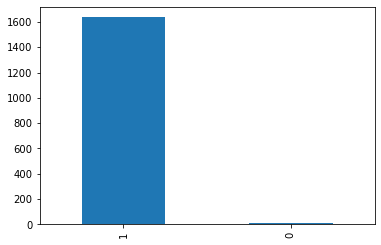

In [248]:
withweap.crit1.value_counts().plot.bar()

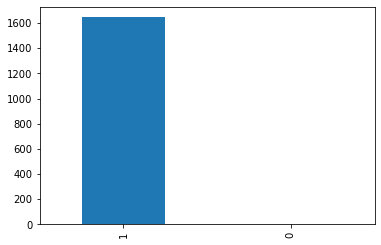

In [249]:
withweap.crit2.value_counts().plot.bar()

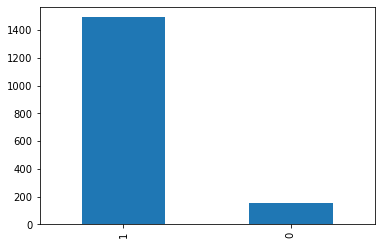

In [250]:
withweap.crit3.value_counts().plot.bar()

# Whether this attact is a real terrorism?

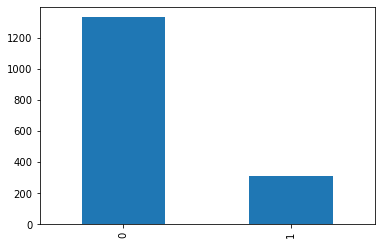

In [251]:
withweap.doubtterr.value_counts().plot.bar()

### Conclusion
Here we will say yes its a real terrorism as in most of the cases its a real terrorism.

# So what should be the attack type?

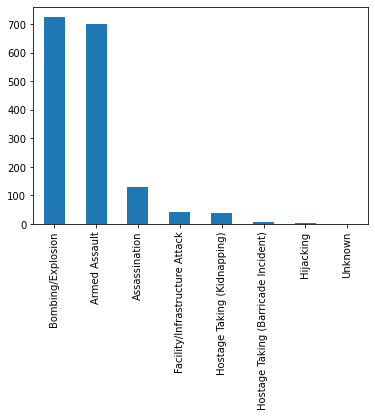

In [252]:
withweap.attacktype1_txt.value_counts().plot.bar()

In [253]:
(withweap.attacktype1_txt.value_counts()/withweap.attacktype1_txt.value_counts().sum())*100 # Percentage of attack type

Bombing/Explosion                      44.046173
Armed Assault                          42.466586
Assassination                           7.897934
Facility/Infrastructure Attack          2.612394
Hostage Taking (Kidnapping)             2.247874
Hostage Taking (Barricade Incident)     0.425273
Hijacking                               0.243013
Unknown                                 0.060753
Name: attacktype1_txt, dtype: float64

### Conclusion
Since they are carring firearms and explosives so they may execute bombing or armed assault

# Who is the target?

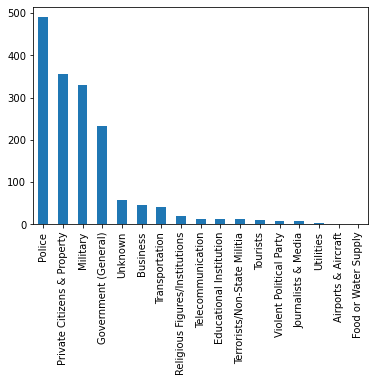

In [254]:
withweap.targtype1_txt.value_counts().plot.bar()

In [255]:
(withweap.targtype1_txt.value_counts()/withweap.targtype1_txt.value_counts().sum())*100 # Percentage of attack on particular target

Police                            29.769137
Private Citizens & Property       21.628190
Military                          19.987849
Government (General)              14.216282
Unknown                            3.462940
Business                           2.794654
Transportation                     2.551640
Religious Figures/Institutions     1.215067
Telecommunication                  0.850547
Educational Institution            0.789793
Terrorists/Non-State Militia       0.729040
Tourists                           0.668287
Violent Political Party            0.546780
Journalists & Media                0.486027
Utilities                          0.182260
Airports & Aircraft                0.060753
Food or Water Supply               0.060753
Name: targtype1_txt, dtype: float64

### Conclusion
Its expected the attack will be on police, citizen, military or on government bodies.

# Given month is October then?

In [256]:
month=10

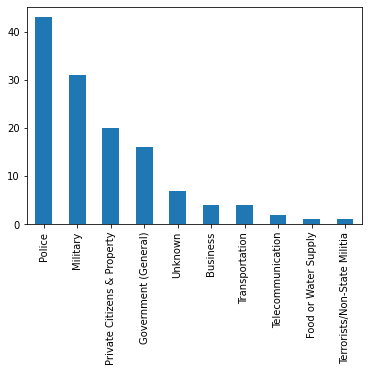

In [257]:
withweap[withweap.imonth==month].targtype1_txt.value_counts().plot.bar()

In [258]:
# Percentage of attack on particular target in particular month
(withweap[withweap.imonth==month].targtype1_txt.value_counts()/withweap[withweap.imonth==month].targtype1_txt.value_counts().sum())*100 

Police                          33.333333
Military                        24.031008
Private Citizens & Property     15.503876
Government (General)            12.403101
Unknown                          5.426357
Business                         3.100775
Transportation                   3.100775
Telecommunication                1.550388
Food or Water Supply             0.775194
Terrorists/Non-State Militia     0.775194
Name: targtype1_txt, dtype: float64

# By whom?

In [259]:
grp = withweap[(withweap.imonth==month) & (withweap.doubtterr==0) & ((withweap.attacktype1==2)|(withweap.attacktype1==3)) &((withweap.targtype1==14)|(withweap.targtype1==3)|(withweap.targtype1==4)|(withweap.targtype1==2))]
grp.head()

,imonth,extended,crit1,crit2,crit3,doubtterr,longitude,latitude,attacktype1,success,...,nkillter,nwound,nwoundte,property,ishostkid,hostkidoutcome,city,weaptype1_txt,targtype1_txt,attacktype1_txt
13,10,0,1,1,1,0,76.576171,33.778175,3,1,...,0,0,0,1,0,-1,Bangwani,Explosives,Private Citizens & Property,Bombing/Explosion
58,10,0,1,1,1,0,74.857026,32.726602,3,1,...,0,20,0,1,0,-1,Jammu,Explosives,Private Citizens & Property,Bombing/Explosion
133,10,0,1,1,1,0,74.789902,34.083740,3,1,...,0,10,0,-1,0,-1,Srinagar,Explosives,Police,Bombing/Explosion
293,10,0,1,1,1,0,74.789902,34.083740,3,1,...,1,60,0,1,0,-1,Srinagar,Explosives,Government (General),Bombing/Explosion
295,10,0,1,1,1,0,76.576171,33.778175,2,1,...,1,3,0,0,0,-1,Charura,Firearms,Police,Armed Assault


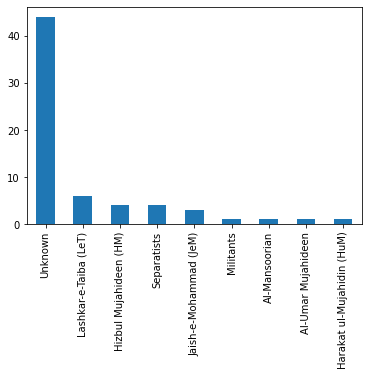

In [260]:
grp.gname.value_counts().plot.bar()

In [261]:
(grp.gname.value_counts()/grp.gname.value_counts().sum())*100 # Percentage of attack by particular group in particular month

Unknown                       67.692308
Lashkar-e-Taiba (LeT)          9.230769
Hizbul Mujahideen (HM)         6.153846
Separatists                    6.153846
Jaish-e-Mohammad (JeM)         4.615385
Militants                      1.538462
Al-Mansoorian                  1.538462
Al-Umar Mujahideen             1.538462
Harakat ul-Mujahidin (HuM)     1.538462
Name: gname, dtype: float64

### Conclusion
Let's filter some information, since this is month of october so its expected that attack will be executed on either police or military by unknown group

# But where?

In [262]:
# Keeping any inclusion criteria and all 4 expected target
loc = withweap[(withweap.imonth==month) & (withweap.doubtterr==0) & ((withweap.attacktype1==2)|(withweap.attacktype1==3)) &((withweap.targtype1==14)|(withweap.targtype1==3)|(withweap.targtype1==4)|(withweap.targtype1==2))]
loc.head()

,imonth,extended,crit1,crit2,crit3,doubtterr,longitude,latitude,attacktype1,success,...,nkillter,nwound,nwoundte,property,ishostkid,hostkidoutcome,city,weaptype1_txt,targtype1_txt,attacktype1_txt
13,10,0,1,1,1,0,76.576171,33.778175,3,1,...,0,0,0,1,0,-1,Bangwani,Explosives,Private Citizens & Property,Bombing/Explosion
58,10,0,1,1,1,0,74.857026,32.726602,3,1,...,0,20,0,1,0,-1,Jammu,Explosives,Private Citizens & Property,Bombing/Explosion
133,10,0,1,1,1,0,74.789902,34.083740,3,1,...,0,10,0,-1,0,-1,Srinagar,Explosives,Police,Bombing/Explosion
293,10,0,1,1,1,0,74.789902,34.083740,3,1,...,1,60,0,1,0,-1,Srinagar,Explosives,Government (General),Bombing/Explosion
295,10,0,1,1,1,0,76.576171,33.778175,2,1,...,1,3,0,0,0,-1,Charura,Firearms,Police,Armed Assault


In [263]:
len(loc)

65

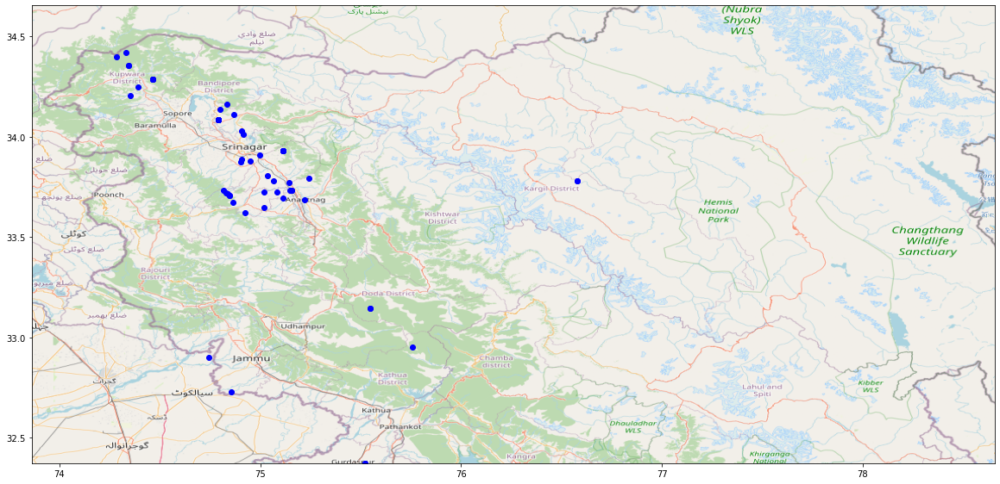

In [264]:
# Plotting all possible locations of attack

BBox = ((df1.longitude.min(),   df1.longitude.max(),      
         df1.latitude.min(), df1.latitude.max()))

fig, ax = plt.subplots(figsize=(20,15)) 

plt.xlim(BBox[0],BBox[1])
plt.ylim(BBox[2],BBox[3])         
                 
plt.scatter(loc.longitude, loc.latitude, alpha=1 , c='b')
jk = plt.imread('map.png')
plt.imshow(jk, extent = BBox)

In [265]:
((loc.city.value_counts()/loc.city.value_counts().sum())*100)[:10] # Percentage of attack on particular city with given filters

Srinagar     21.538462
Tral          9.230769
Sopore        6.153846
Anantnag      3.076923
Kralagund     3.076923
Kathua        3.076923
Shopian       3.076923
Memender      1.538462
Pampore       1.538462
Doda          1.538462
Name: city, dtype: float64

<br>

### Attack on Private citizen and property or on Police

In [266]:
# Keeping any inclusion criteria and only 2 targets
loc1 = withweap[(withweap.imonth==month) & (withweap.doubtterr==0) & ((withweap.attacktype1==2)|(withweap.attacktype1==3)) &((withweap.targtype1==14)|(withweap.targtype1==3))]
loc1.head()

,imonth,extended,crit1,crit2,crit3,doubtterr,longitude,latitude,attacktype1,success,...,nkillter,nwound,nwoundte,property,ishostkid,hostkidoutcome,city,weaptype1_txt,targtype1_txt,attacktype1_txt
13,10,0,1,1,1,0,76.576171,33.778175,3,1,...,0,0,0,1,0,-1,Bangwani,Explosives,Private Citizens & Property,Bombing/Explosion
58,10,0,1,1,1,0,74.857026,32.726602,3,1,...,0,20,0,1,0,-1,Jammu,Explosives,Private Citizens & Property,Bombing/Explosion
133,10,0,1,1,1,0,74.789902,34.083740,3,1,...,0,10,0,-1,0,-1,Srinagar,Explosives,Police,Bombing/Explosion
295,10,0,1,1,1,0,76.576171,33.778175,2,1,...,1,3,0,0,0,-1,Charura,Firearms,Police,Armed Assault
297,10,0,1,1,1,0,75.522909,32.371698,3,1,...,0,3,0,0,0,-1,Kathua,Explosives,Police,Bombing/Explosion


In [267]:
len(loc1)

49

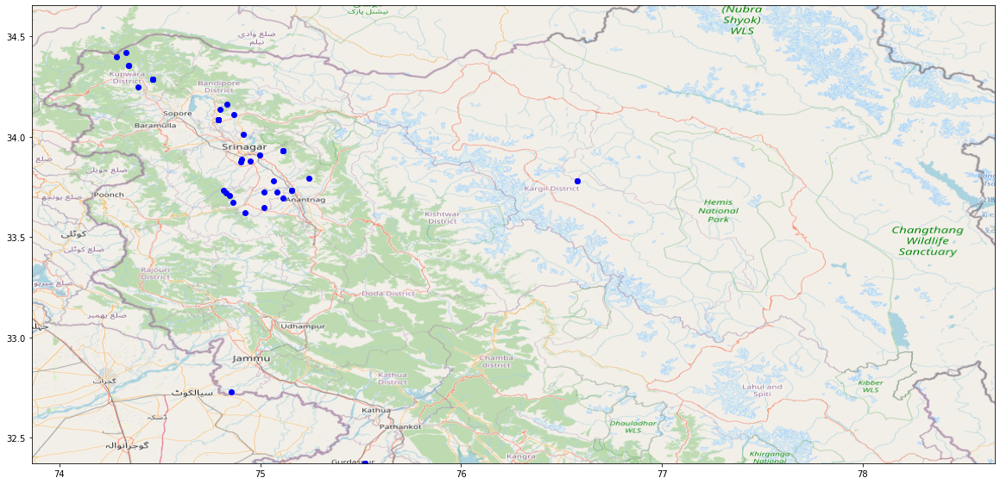

In [268]:
# Plotting all possible locations of attack on citizen or police

BBox = ((df1.longitude.min(),   df1.longitude.max(),      
         df1.latitude.min(), df1.latitude.max()))

fig, ax = plt.subplots(figsize=(20,15)) 

plt.xlim(BBox[0],BBox[1])
plt.ylim(BBox[2],BBox[3])         
                 
plt.scatter(loc1.longitude, loc1.latitude, alpha=1 , c='b')
jk = plt.imread('map.png')
plt.imshow(jk, extent = BBox)

In [269]:
((loc1.city.value_counts()/loc1.city.value_counts().sum())*100)[:10] # Percentage of attack on particular city with given filters

Srinagar     22.448980
Tral         10.204082
Sopore        8.163265
Kralagund     4.081633
Kathua        4.081633
Shopian       4.081633
Anantnag      4.081633
Qaimoh        2.040816
Tootigund     2.040816
Zakura        2.040816
Name: city, dtype: float64

### Conclusion

If attack is on citizen or on police then it will executed in Srinagar

### Attack on military or government

In [270]:
# Keeping any inclusion criteria and all 2 expected target
loc2 = withweap[(withweap.imonth==month) & (withweap.doubtterr==0) & ((withweap.attacktype1==2)|(withweap.attacktype1==3)) &((withweap.targtype1==4)|(withweap.targtype1==2))]
loc2.head()

,imonth,extended,crit1,crit2,crit3,doubtterr,longitude,latitude,attacktype1,success,...,nkillter,nwound,nwoundte,property,ishostkid,hostkidoutcome,city,weaptype1_txt,targtype1_txt,attacktype1_txt
293,10,0,1,1,1,0,74.789902,34.083740,3,1,...,1,60,0,1,0,-1,Srinagar,Explosives,Government (General),Bombing/Explosion
296,10,0,1,1,1,0,74.789902,34.083740,3,1,...,0,3,0,0,0,-1,Srinagar,Explosives,Military,Bombing/Explosion
418,10,0,1,1,1,0,75.548049,33.145750,2,1,...,1,-1,0,-1,0,-1,Doda,Explosives,Government (General),Armed Assault
633,10,0,1,1,1,0,75.548049,33.145750,2,0,...,0,-1,0,-1,0,-1,Doda district,Firearms,Government (General),Armed Assault
798,10,0,1,1,1,0,74.353867,34.205605,3,1,...,0,9,0,-1,0,-1,Baramulla,Explosives,Military,Bombing/Explosion


In [271]:
len(loc2)

16

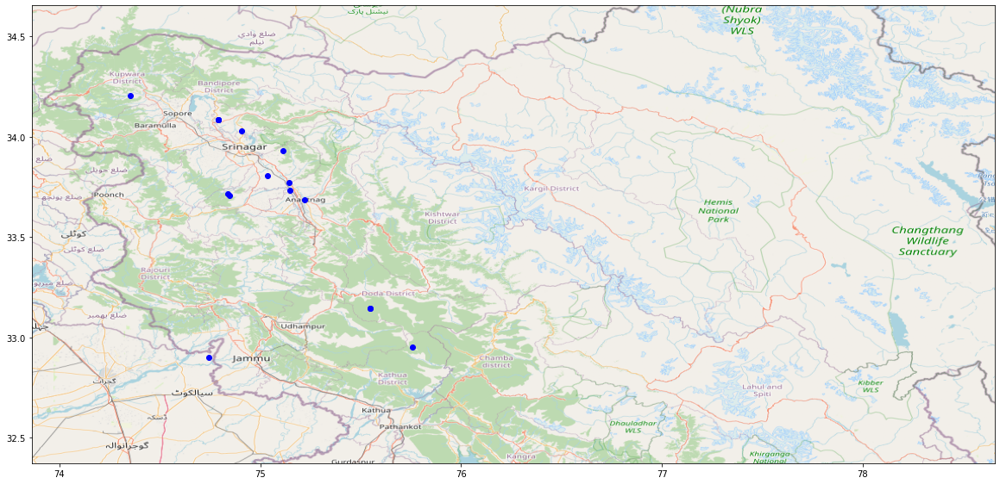

In [272]:
# Plotting all possible locations of attack on military and government

BBox = ((df1.longitude.min(),   df1.longitude.max(),      
         df1.latitude.min(), df1.latitude.max()))

fig, ax = plt.subplots(figsize=(20,15)) 

plt.xlim(BBox[0],BBox[1])
plt.ylim(BBox[2],BBox[3])         
                 
plt.scatter(loc2.longitude, loc2.latitude, alpha=1 , c='b')
jk = plt.imread('map.png')
plt.imshow(jk, extent = BBox)

In [273]:
(loc2.city.value_counts()/loc2.city.value_counts().sum())*100

Srinagar            18.75
Doda                 6.25
Ganjiwada            6.25
Sempora              6.25
Veeri                6.25
Wachi                6.25
Achabal              6.25
Haddal               6.25
Shopian district     6.25
Baramulla            6.25
Akhnoor              6.25
Tral                 6.25
Doda district        6.25
Memender             6.25
Name: city, dtype: float64

### Conclusion

If attack is on military or on government then it may be executed in Srinagar

And to prevent the attack we need to increase the security at these locations